#A header including some libraries we may use

In [398]:
#some identefiers that we will probably use!
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import xgboost as xgb
import plotly.express as px
import seaborn as sns
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, precision_score, accuracy_score, recall_score, balanced_accuracy_score
from sklearn.svm import SVC
svc = SVC(kernel='linear')
from sklearn.svm import LinearSVC, SVC
import sklearn.metrics as metrics
from sklearn.metrics import confusion_matrix
np.random.seed(42)

#Loading data

Firstly we need to load the data

In [399]:
data = pd.read_csv('/content/drive/MyDrive/music data/dataset.csv')

In [400]:
data #checking that the data is loaded properly

,Artist,Title,Label,feature1,feature2,feature3,feature4,feature5,feature6,feature7,...,feature509,feature510,feature511,feature512,feature513,feature514,feature515,feature516,feature517,feature518
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-25.679245,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-35.063976,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-46.182686,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-72.993797,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-35.882221,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-33.352566,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-44.713177,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.441772
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-29.915636,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-47.953896,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


#Renaming Data columns to usable indecies

In [401]:
mfcc_columns=list(range(3,3+140)) #the range of the feature
print(mfcc_columns) #printing the numbers just to check that the indecies were recorded correctly
mfcc_names= list (range(140)) #making an empty list with the number of the required feature
for i in range (140) :
  mfcc_names[i] = 'mfcc_'+ str(i+1) #filling in the list with the required column names
print(mfcc_names) #printing the names just to check the everything is going right
data.rename(columns=dict(zip(data.columns[mfcc_columns], mfcc_names)),inplace=True) #replacing the names of the columns correctly

[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142]
['mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8', 'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20', 'mfcc_21', 'mfcc_22', 'mfcc_23', 'mfcc_24', 'mfcc_25', 'mfcc_26', 'mfcc_27', 'mfcc_28', 'mfcc_29', 'mfcc_30', 'mfcc_31', 'mfcc_32', 'mfcc_33', 'mfcc_34', 'mfcc_35', 'mfcc_36', 'mfcc_37', 'mfc

In [402]:
chroma_stft=list(range(143,143+84))
print(chroma_stft)
chroma_stft_names= list (range(84))
for i in range (84) :
  chroma_stft_names[i] = 'chroma_stft_'+ str(i+1)
print(chroma_stft_names)
data.rename(columns=dict(zip(data.columns[chroma_stft], chroma_stft_names)),inplace=True)

[143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226]
['chroma_stft_1', 'chroma_stft_2', 'chroma_stft_3', 'chroma_stft_4', 'chroma_stft_5', 'chroma_stft_6', 'chroma_stft_7', 'chroma_stft_8', 'chroma_stft_9', 'chroma_stft_10', 'chroma_stft_11', 'chroma_stft_12', 'chroma_stft_13', 'chroma_stft_14', 'chroma_stft_15', 'chroma_stft_16', 'chroma_stft_17', 'chroma_stft_18', 'chroma_stft_19', 'chroma_stft_20', 'chroma_stft_21', 'chroma_stft_22', 'chroma_stft_23', 'chroma_stft_24', 'chroma_stft_25', 'chroma_stft_26', 'chroma_stft_27', 'chroma_stft_28', 'chroma_stft_29', 'chroma_stft_30', 'chroma_stft_31', 'chroma_stft_32', 'chroma_stf

In [403]:
spectral_centroid=list(range(227,227+7))
print(spectral_centroid)
spectral_centroid_names= list (range(7))
for i in range (7) :
  spectral_centroid_names[i] = 'spectral_centroid_'+ str(i+1)
print(spectral_centroid_names)
data.rename(columns=dict(zip(data.columns[spectral_centroid], spectral_centroid_names)),inplace=True)

[227, 228, 229, 230, 231, 232, 233]
['spectral_centroid_1', 'spectral_centroid_2', 'spectral_centroid_3', 'spectral_centroid_4', 'spectral_centroid_5', 'spectral_centroid_6', 'spectral_centroid_7']


In [404]:
spectral_bandwidth=list(range(234,234+7))
print(spectral_bandwidth)
spectral_bandwidth_names= list (range(7))
for i in range (7) :
  spectral_bandwidth_names[i] = 'spectral_bandwidth_'+ str(i+1)
print(spectral_bandwidth_names)
data.rename(columns=dict(zip(data.columns[spectral_bandwidth], spectral_bandwidth_names)),inplace=True)

[234, 235, 236, 237, 238, 239, 240]
['spectral_bandwidth_1', 'spectral_bandwidth_2', 'spectral_bandwidth_3', 'spectral_bandwidth_4', 'spectral_bandwidth_5', 'spectral_bandwidth_6', 'spectral_bandwidth_7']


In [405]:
rolloff=list(range(241,241+7))
print(rolloff)
rolloff_names= list (range(7))
for i in range (7) :
  rolloff_names[i] = 'rolloff_'+ str(i+1)
print(rolloff_names)
data.rename(columns=dict(zip(data.columns[rolloff], rolloff_names)),inplace=True)

[241, 242, 243, 244, 245, 246, 247]
['rolloff_1', 'rolloff_2', 'rolloff_3', 'rolloff_4', 'rolloff_5', 'rolloff_6', 'rolloff_7']


In [406]:
zero_crossing_rate=list(range(248,248+7))
print(zero_crossing_rate)
zero_crossing_rate_names= list (range(7))
for i in range (7) :
  zero_crossing_rate_names[i] = 'zero_crossing_rate_'+ str(i+1)
print(zero_crossing_rate_names)
data.rename(columns=dict(zip(data.columns[zero_crossing_rate], zero_crossing_rate_names)),inplace=True)

[248, 249, 250, 251, 252, 253, 254]
['zero_crossing_rate_1', 'zero_crossing_rate_2', 'zero_crossing_rate_3', 'zero_crossing_rate_4', 'zero_crossing_rate_5', 'zero_crossing_rate_6', 'zero_crossing_rate_7']


In [407]:
chroma_cqt=list(range(255,255+84))
print(chroma_cqt)
chroma_cqt_names= list (range(84))
for i in range (84) :
  chroma_cqt_names[i] = 'chroma_cqt_'+ str(i+1)
print(chroma_cqt_names)
data.rename(columns=dict(zip(data.columns[chroma_cqt], chroma_cqt_names)),inplace=True)

[255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338]
['chroma_cqt_1', 'chroma_cqt_2', 'chroma_cqt_3', 'chroma_cqt_4', 'chroma_cqt_5', 'chroma_cqt_6', 'chroma_cqt_7', 'chroma_cqt_8', 'chroma_cqt_9', 'chroma_cqt_10', 'chroma_cqt_11', 'chroma_cqt_12', 'chroma_cqt_13', 'chroma_cqt_14', 'chroma_cqt_15', 'chroma_cqt_16', 'chroma_cqt_17', 'chroma_cqt_18', 'chroma_cqt_19', 'chroma_cqt_20', 'chroma_cqt_21', 'chroma_cqt_22', 'chroma_cqt_23', 'chroma_cqt_24', 'chroma_cqt_25', 'chroma_cqt_26', 'chroma_cqt_27', 'chroma_cqt_28', 'chroma_cqt_29', 'chroma_cqt_30', 'chroma_cqt_31', 'chroma_cqt_32', 'chroma_cqt_33', 'chroma_cqt_34', 'chroma_c

In [408]:
chroma_cens=list(range(339,339+84))
print(chroma_cens)
chroma_cens_names= list (range(84))
for i in range (84) :
  chroma_cens_names[i] = 'chroma_cens_'+ str(i+1)
print(chroma_cens_names)
data.rename(columns=dict(zip(data.columns[chroma_cens], chroma_cens_names)),inplace=True)

[339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 399, 400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 422]
['chroma_cens_1', 'chroma_cens_2', 'chroma_cens_3', 'chroma_cens_4', 'chroma_cens_5', 'chroma_cens_6', 'chroma_cens_7', 'chroma_cens_8', 'chroma_cens_9', 'chroma_cens_10', 'chroma_cens_11', 'chroma_cens_12', 'chroma_cens_13', 'chroma_cens_14', 'chroma_cens_15', 'chroma_cens_16', 'chroma_cens_17', 'chroma_cens_18', 'chroma_cens_19', 'chroma_cens_20', 'chroma_cens_21', 'chroma_cens_22', 'chroma_cens_23', 'chroma_cens_24', 'chroma_cens_25', 'chroma_cens_26', 'chroma_cens_27', 'chroma_cens_28', 'chroma_cens_29', 'chroma_cens_30', 'chroma_cens_31', 'chroma_cens_32', 'chroma_cen

In [409]:
rms=list(range(423,423+7))
print(rms)
rms_names= list (range(7))
for i in range (7) :
  rms_names[i] = 'rms_'+ str(i+1)
print(rms_names)
data.rename(columns=dict(zip(data.columns[rms], rms_names)),inplace=True)

[423, 424, 425, 426, 427, 428, 429]
['rms_1', 'rms_2', 'rms_3', 'rms_4', 'rms_5', 'rms_6', 'rms_7']


In [410]:
spectral_contrast=list(range(430,430+49))
print(spectral_contrast)
spectral_contrast_names= list (range(49))
for i in range (49) :
  spectral_contrast_names[i] = 'spectral_contrast_'+ str(i+1)
print(spectral_contrast_names)
data.rename(columns=dict(zip(data.columns[spectral_contrast], spectral_contrast_names)),inplace=True)

[430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478]
['spectral_contrast_1', 'spectral_contrast_2', 'spectral_contrast_3', 'spectral_contrast_4', 'spectral_contrast_5', 'spectral_contrast_6', 'spectral_contrast_7', 'spectral_contrast_8', 'spectral_contrast_9', 'spectral_contrast_10', 'spectral_contrast_11', 'spectral_contrast_12', 'spectral_contrast_13', 'spectral_contrast_14', 'spectral_contrast_15', 'spectral_contrast_16', 'spectral_contrast_17', 'spectral_contrast_18', 'spectral_contrast_19', 'spectral_contrast_20', 'spectral_contrast_21', 'spectral_contrast_22', 'spectral_contrast_23', 'spectral_contrast_24', 'spectral_contrast_25', 'spectral_contrast_26', 'spectral_contrast_27', 'spectral_contrast_28', 'spectral_contrast_29', 'spectral_contrast_30', 'spectral_contrast_31', 'spectral_contrast

In [411]:
tonnetz=list(range(479,479+42))
print(tonnetz)
tonnetz_names= list (range(42))
for i in range (42) :
  tonnetz_names[i] = 'tonnetz_'+ str(i+1)
print(tonnetz_names)
data.rename(columns=dict(zip(data.columns[tonnetz], tonnetz_names)),inplace=True)

[479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 501, 502, 503, 504, 505, 506, 507, 508, 509, 510, 511, 512, 513, 514, 515, 516, 517, 518, 519, 520]
['tonnetz_1', 'tonnetz_2', 'tonnetz_3', 'tonnetz_4', 'tonnetz_5', 'tonnetz_6', 'tonnetz_7', 'tonnetz_8', 'tonnetz_9', 'tonnetz_10', 'tonnetz_11', 'tonnetz_12', 'tonnetz_13', 'tonnetz_14', 'tonnetz_15', 'tonnetz_16', 'tonnetz_17', 'tonnetz_18', 'tonnetz_19', 'tonnetz_20', 'tonnetz_21', 'tonnetz_22', 'tonnetz_23', 'tonnetz_24', 'tonnetz_25', 'tonnetz_26', 'tonnetz_27', 'tonnetz_28', 'tonnetz_29', 'tonnetz_30', 'tonnetz_31', 'tonnetz_32', 'tonnetz_33', 'tonnetz_34', 'tonnetz_35', 'tonnetz_36', 'tonnetz_37', 'tonnetz_38', 'tonnetz_39', 'tonnetz_40', 'tonnetz_41', 'tonnetz_42']


In [412]:
data

,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_7,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-25.679245,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-35.063976,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-46.182686,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-72.993797,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-35.882221,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-33.352566,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-44.713177,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.441772
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-29.915636,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-47.953896,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


#Treating null values and cheching for dublicates

In [413]:
data.isnull().sum() #checking for null values

Artist        0
Title         0
Label         0
mfcc_1        2
mfcc_2        2
             ..
tonnetz_38    2
tonnetz_39    2
tonnetz_40    2
tonnetz_41    2
tonnetz_42    2
Length: 521, dtype: int64

seems like there are two songs with no feautures at all so dropping the two songs would be the right decision as filling in by mean or median values wouldn't make much sense for an empty song

In [414]:
data=data.dropna() #dropping the nulls

In [415]:
data.isnull().sum()

Artist        0
Title         0
Label         0
mfcc_1        0
mfcc_2        0
             ..
tonnetz_38    0
tonnetz_39    0
tonnetz_40    0
tonnetz_41    0
tonnetz_42    0
Length: 521, dtype: int64

perfect no nulls

In [416]:
duplicate = data.duplicated() #checking for dublicates
duplicate.sum()

0

there are no dublicates which means that the data collecting was done perfectly

#Checking for outliers and treating them

before analysing the data we have to check for and treat outliers

In [417]:
def ranged_boxplot(data,feture_name,rangex):
 for i in range(rangex): #a ranged for loop to loop over the columns of a certain feature
  plt.figure(figsize=(8,4))
  data.boxplot(column=str(feture_name)+str(int(i+1))) #the lopp expression

<ipython-input-417-274888e3d436>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


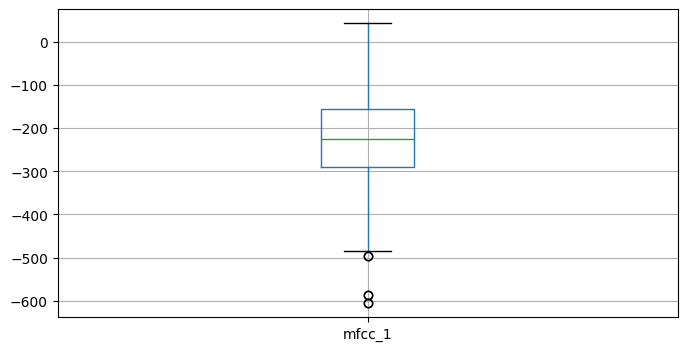

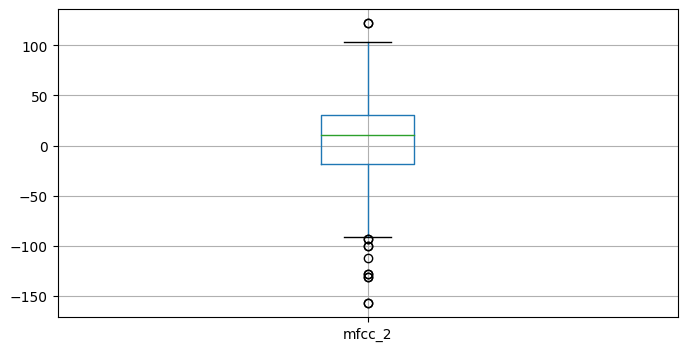

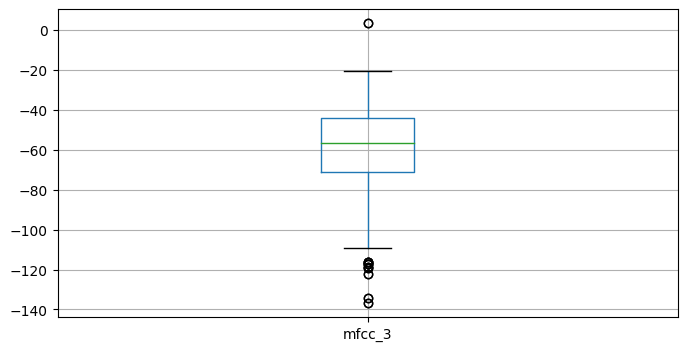

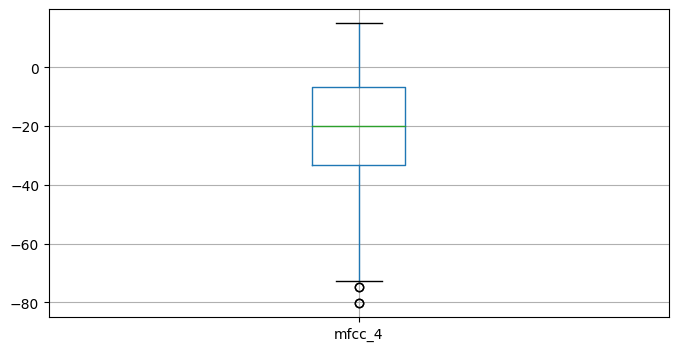

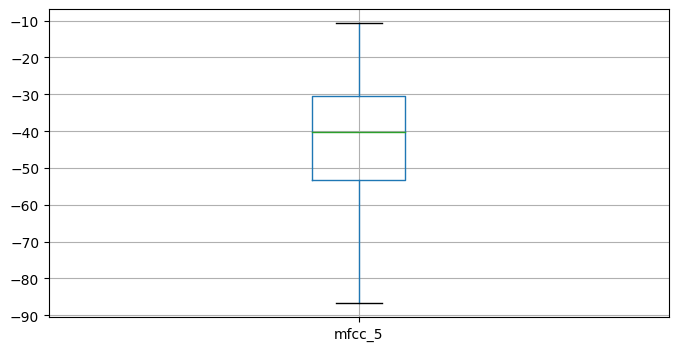

...

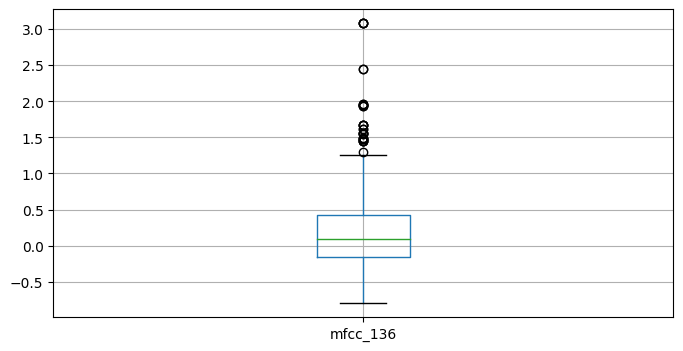

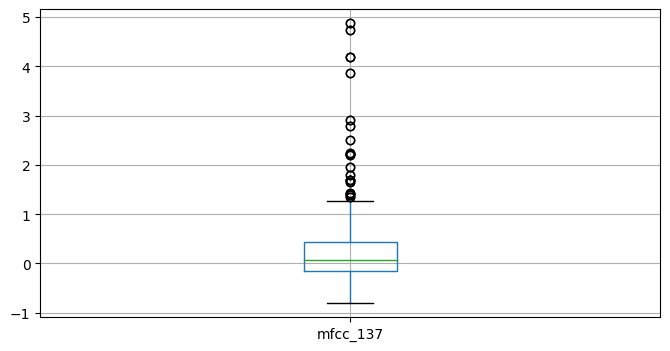

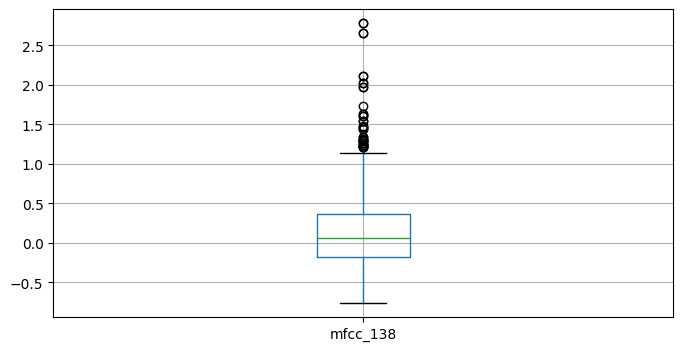

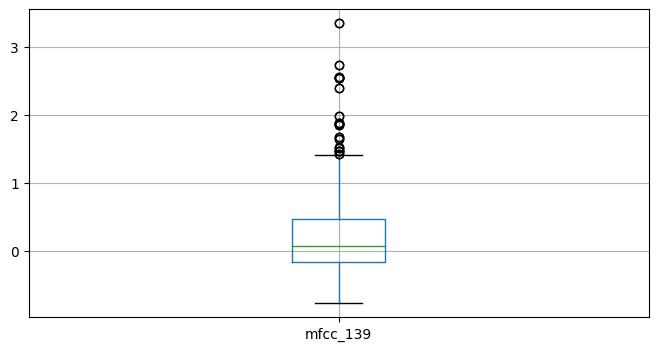

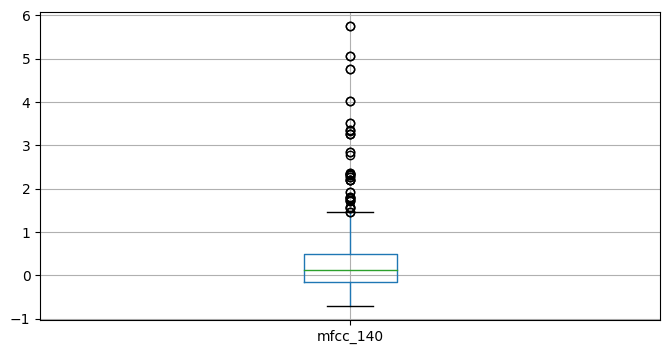

In [418]:
ranged_boxplot(data,'mfcc_',140)

since the data is very small and the outliers are alot we have to treat them by filling in with the upper IQR and lower IQR deleting them would just delete most of the data that we have whcih is already small

In [419]:
def l_and_u (column):   #function to extract the lower and upper IQR values
  sorted(column) #sorting to get the Q1 and Q3 using the quartile function
  Q1,Q3=column.quantile([0.25,0.75]) #extraction Q1 and Q3
  IQR=Q3-Q1 #geting the IQR (inter quartile range)
  lower_range=Q1-(1.5*IQR) #calculating the lower bound of our box
  upper_range=Q3+(1.5*IQR) #calculating the upper bound of our box
  return upper_range,lower_range

In [420]:
def outlier_change (column):
 high_IOS,low_IOS = l_and_u(column) #calculating the upper and lower bounds
 column=np.where(column>high_IOS,high_IOS,column) #replacing the values higher than the upper bound with the upper bound
 column=np.where(column<low_IOS,low_IOS,column) #replacing the values lower than the lower bound with the lower bound
 return column

In [421]:
def ranged_change_outlier (data,feture_name,rangex) : #the data reperesnts the data frame to work on the feuture name is the feature to tune and the range represents the range that feature takes in our data frame
 for i in range (int(rangex)) : #a loop to loop over the specified range
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
 return data

In [422]:
data = ranged_change_outlier(data,'mfcc_',140) #Changing outliers to desired values

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

<ipython-input-417-274888e3d436>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


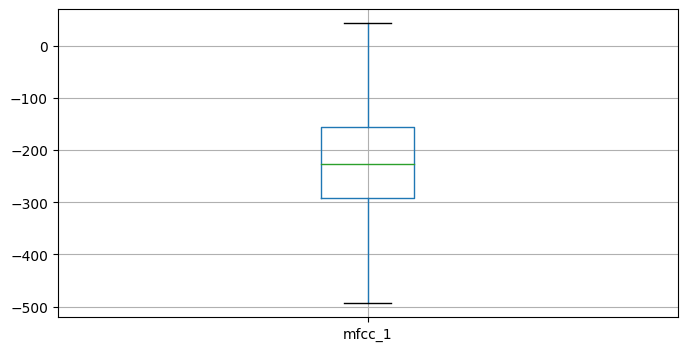

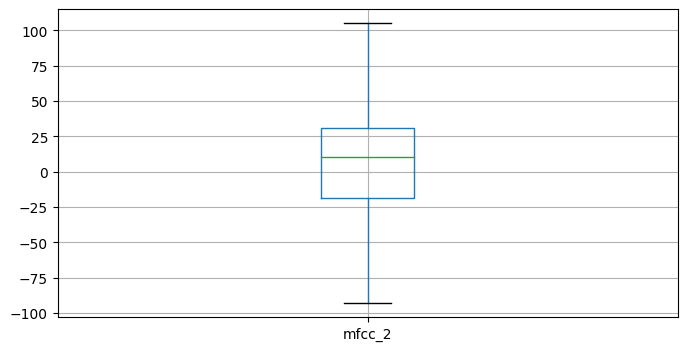

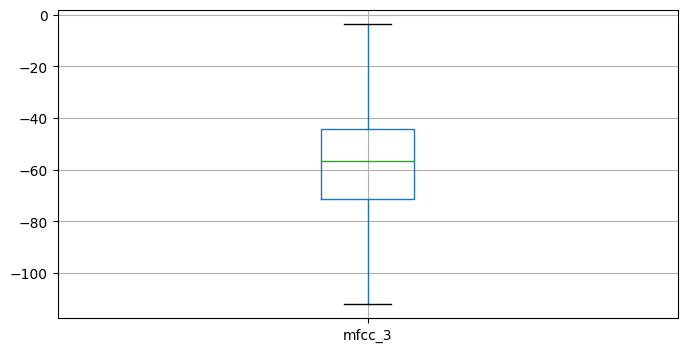

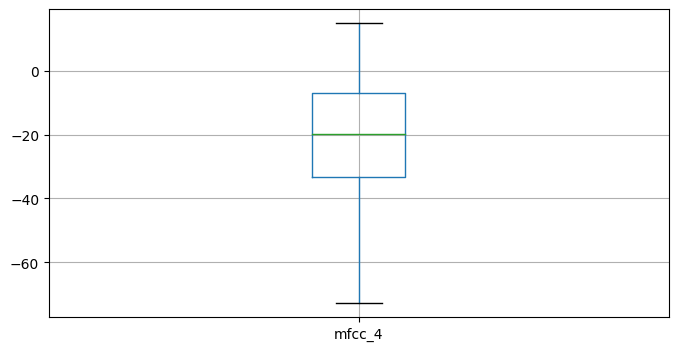

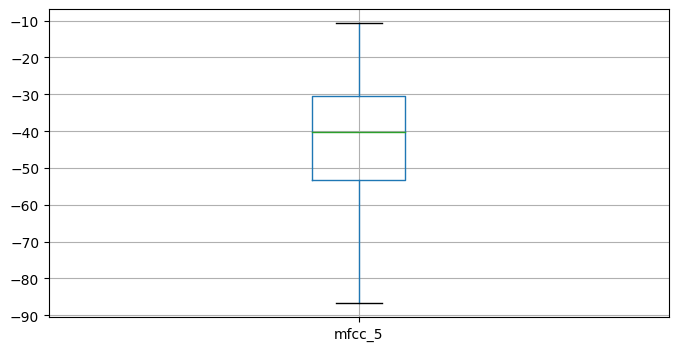

...

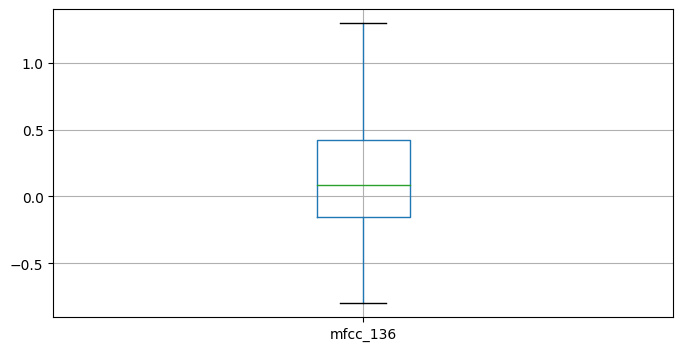

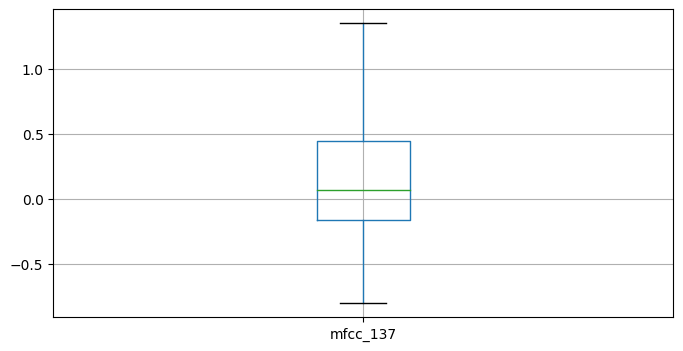

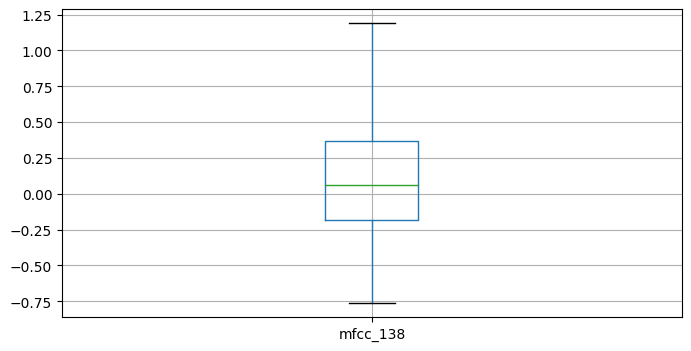

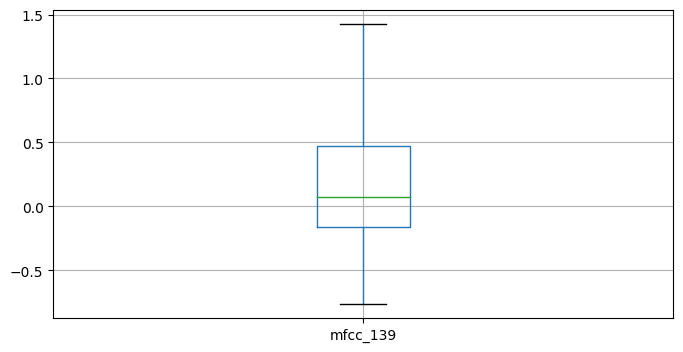

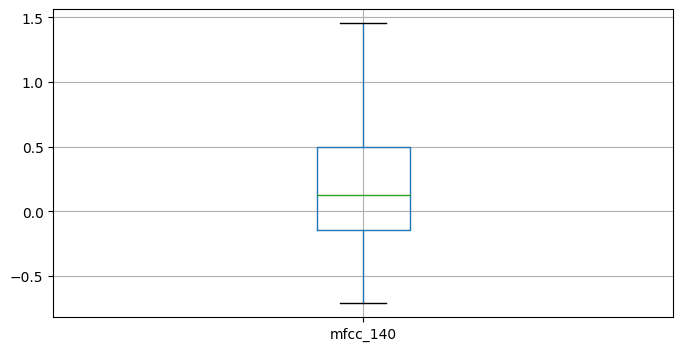

In [423]:
ranged_boxplot(data,'mfcc_',140)

In [ ]:
ranged_boxplot(data,'chroma_stft_',84)

the same goes for chroma stft

In [425]:
data = ranged_change_outlier(data,'chroma_stft_',84)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

<ipython-input-417-274888e3d436>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


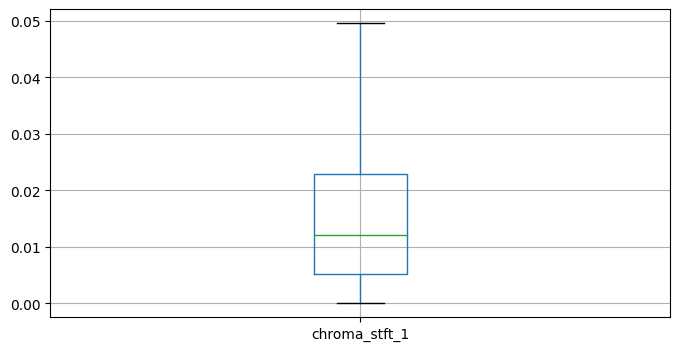

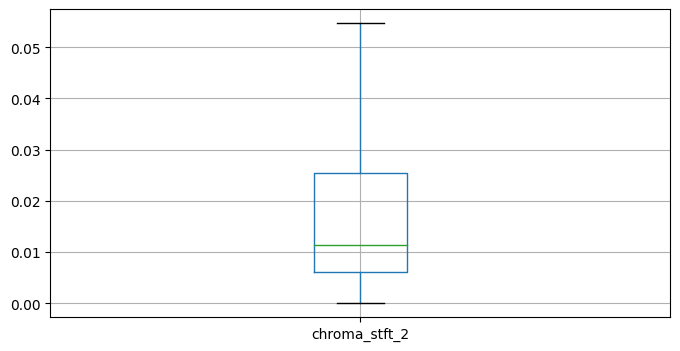

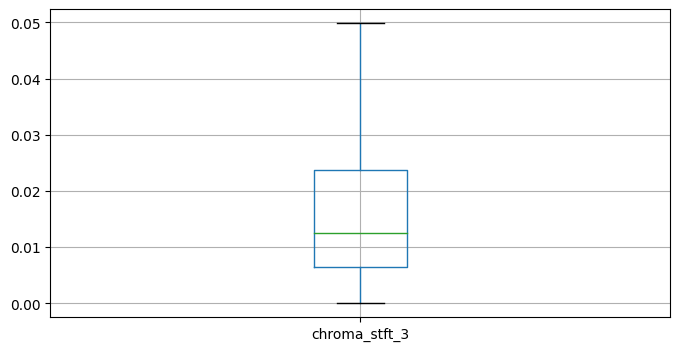

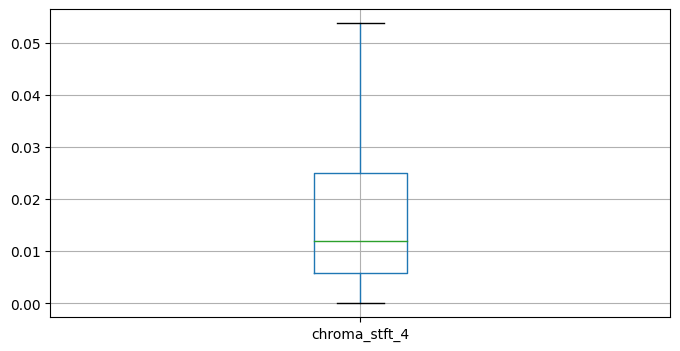

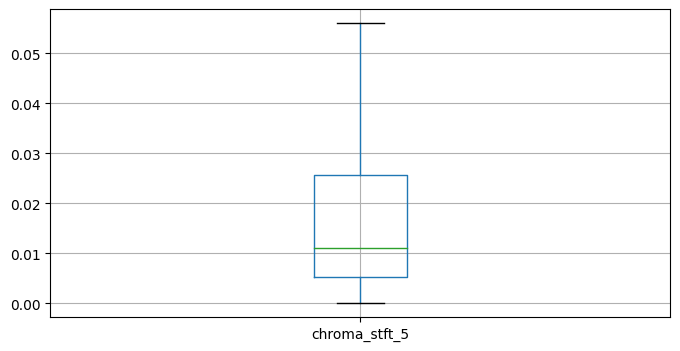

...

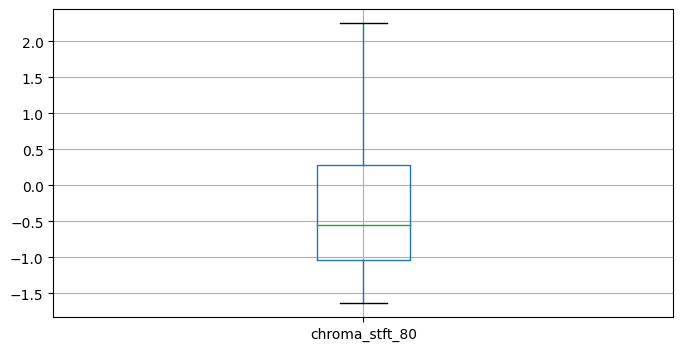

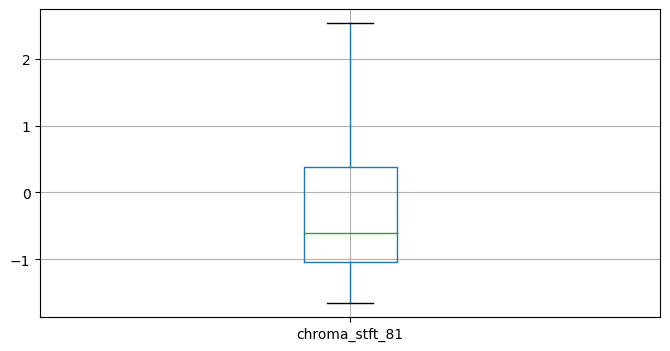

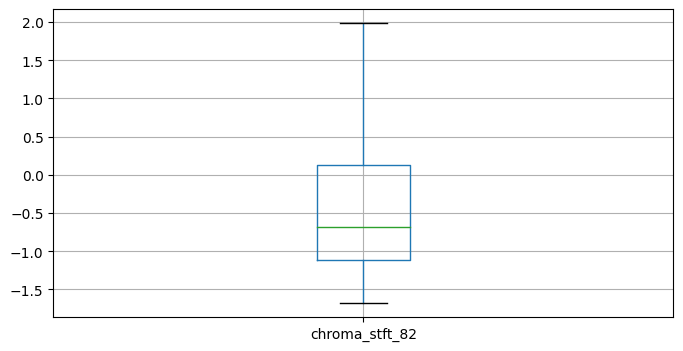

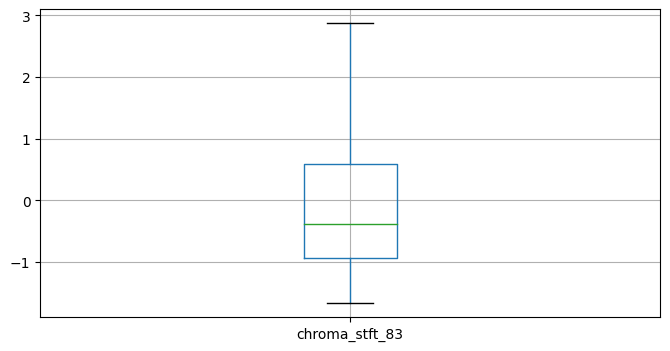

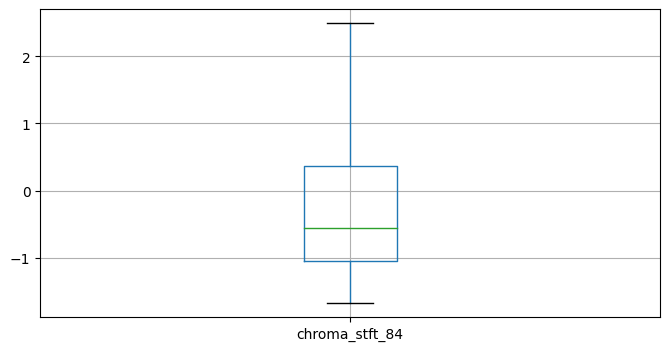

In [426]:
ranged_boxplot(data,'chroma_stft_',84)

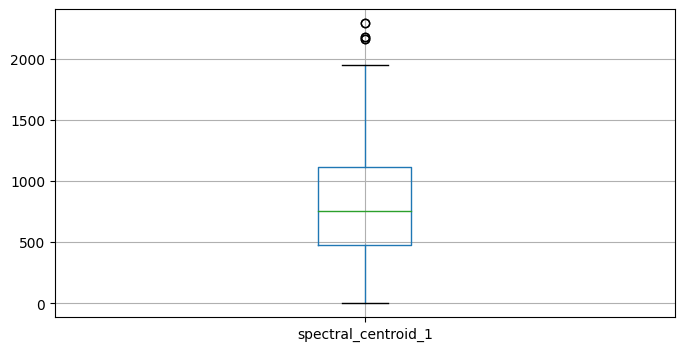

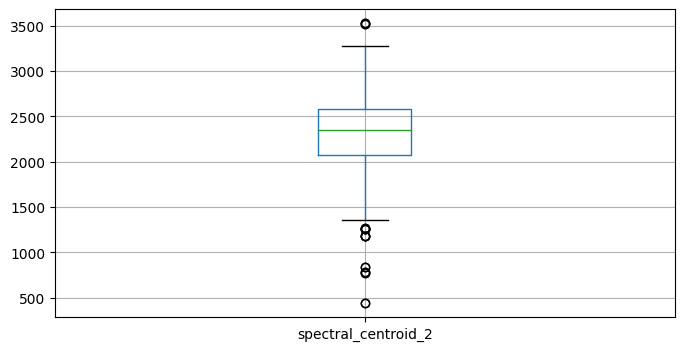

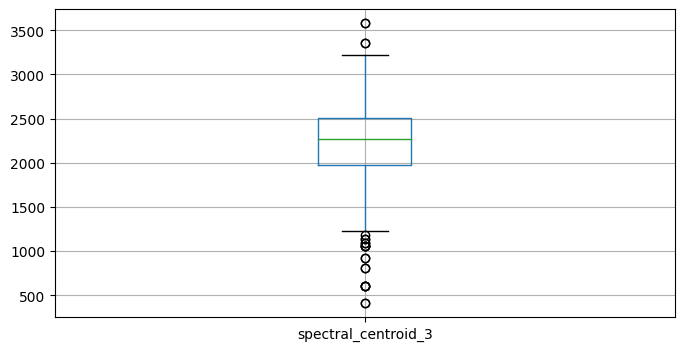

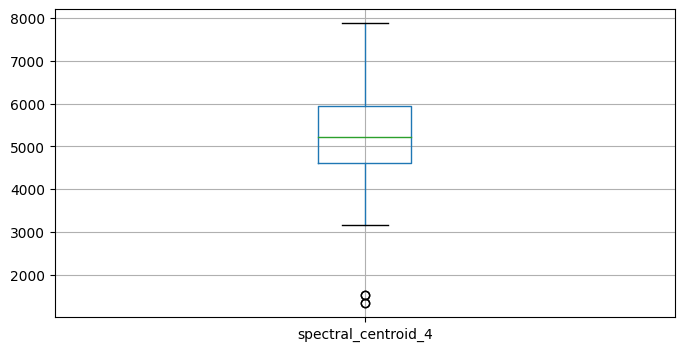

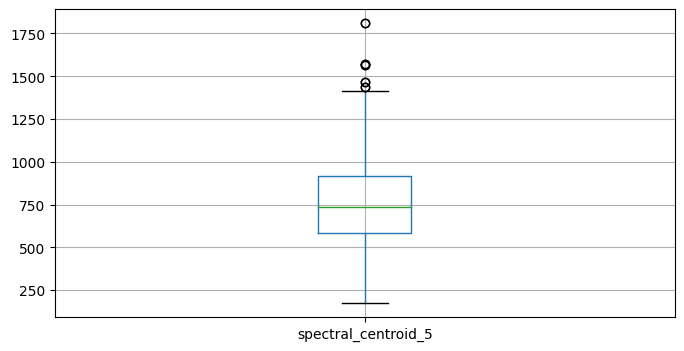

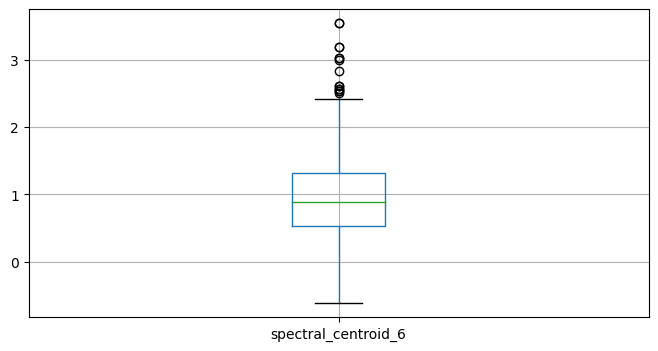

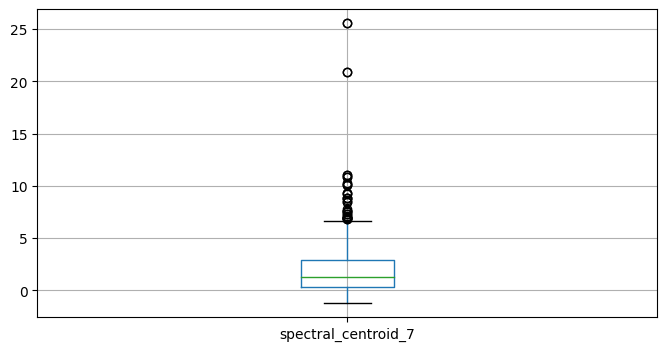

In [427]:
ranged_boxplot(data,'spectral_centroid_',7)

In [428]:
data = ranged_change_outlier(data,'spectral_centroid_',7)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

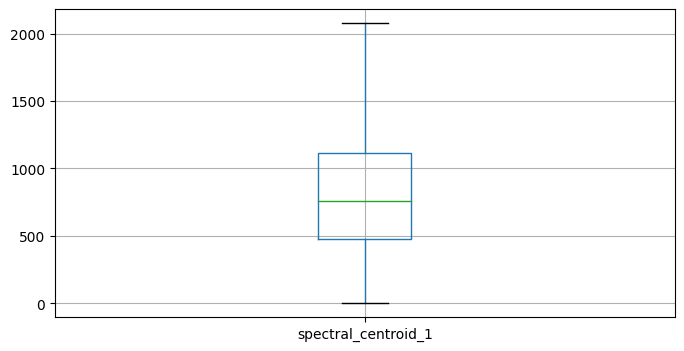

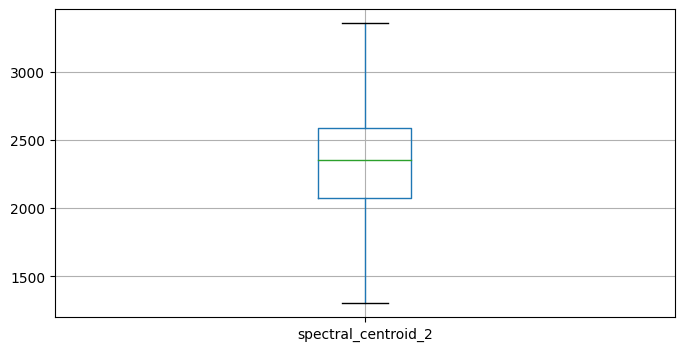

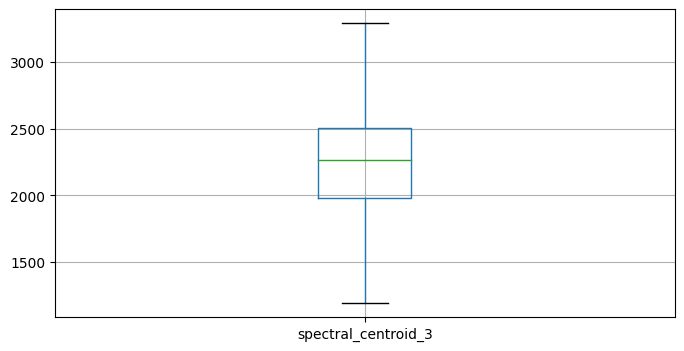

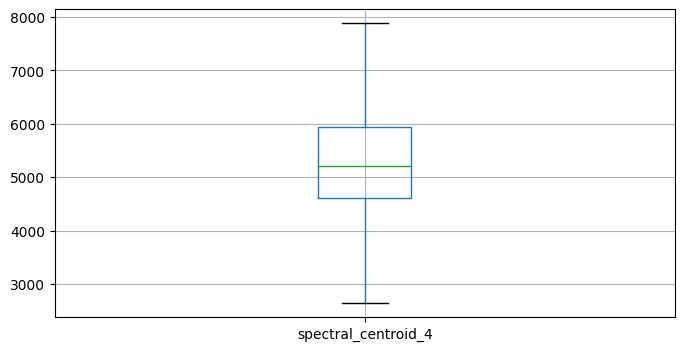

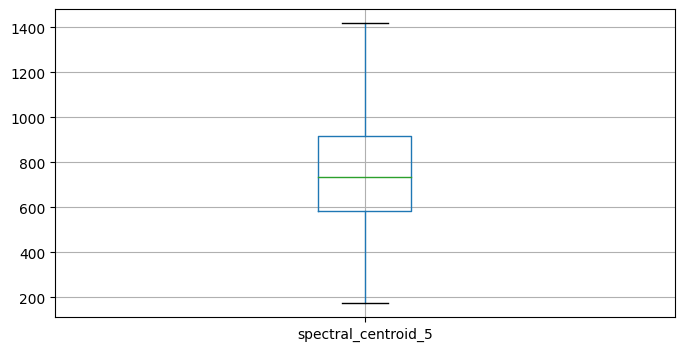

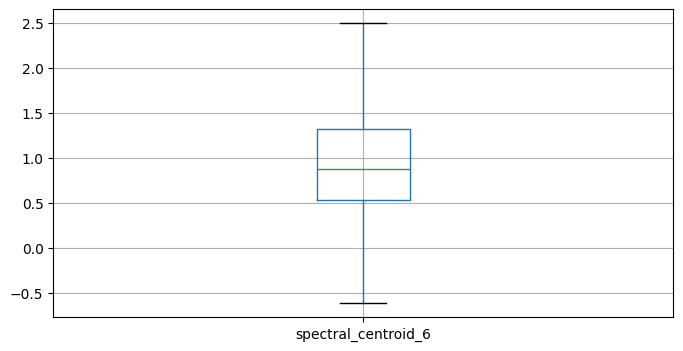

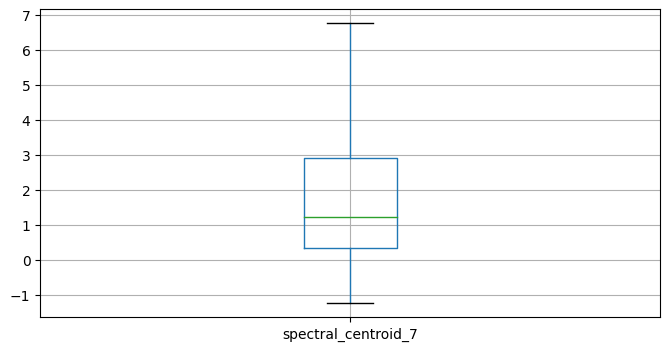

In [429]:
ranged_boxplot(data,'spectral_centroid_',7)

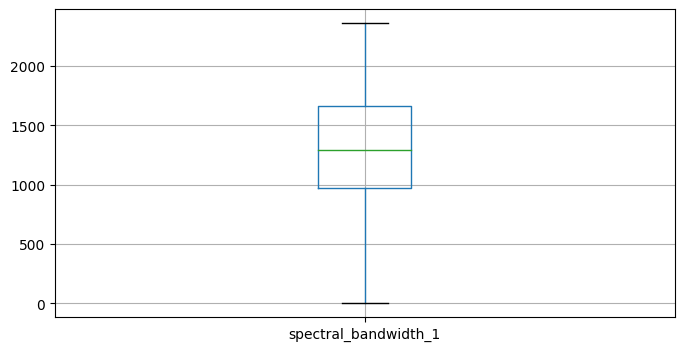

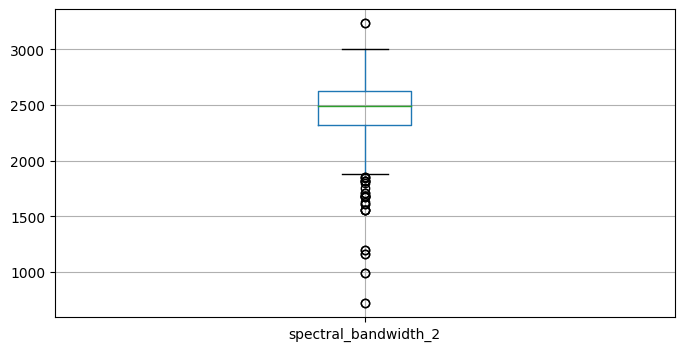

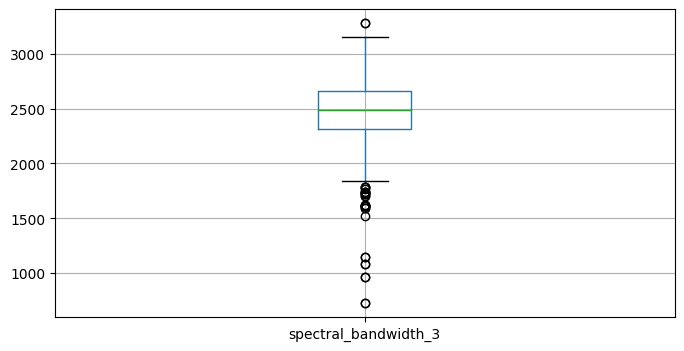

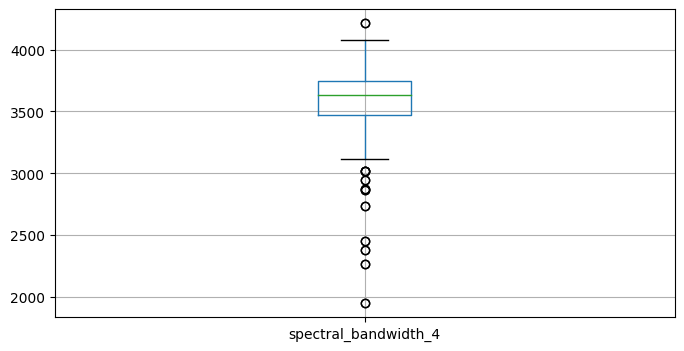

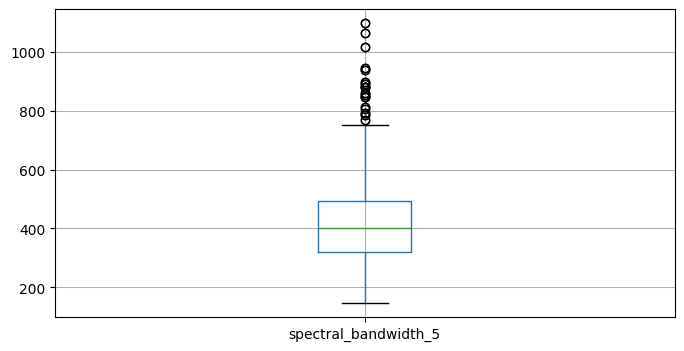

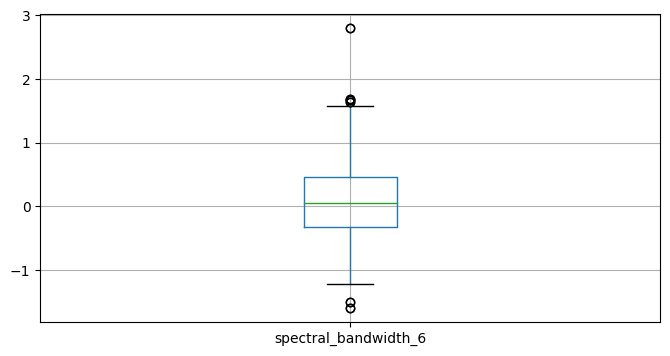

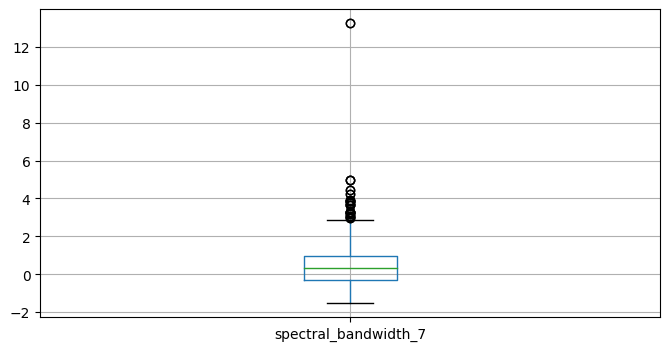

In [430]:
ranged_boxplot(data,'spectral_bandwidth_',7)

In [431]:
data = ranged_change_outlier(data,'spectral_bandwidth_',7)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'spectral_bandwidth_',7)

In [ ]:
ranged_boxplot(data,'rolloff_',7)

In [434]:
data = ranged_change_outlier(data,'rolloff_',7)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'rolloff_',7)

In [ ]:
ranged_boxplot(data,'zero_crossing_rate_',7)

In [437]:
data = ranged_change_outlier(data,'zero_crossing_rate_',7)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'zero_crossing_rate_',7)

In [ ]:
ranged_boxplot(data,'chroma_cqt_',84)

the chroma cqt has alot of outliers and are very varying in range so we will long tranform it so it may be more normally distributed while still kepping the empathis on the different values

In [440]:
for i in range (84):
  data['chroma_cqt_'+str(i+1)]=np.log(data['chroma_cqt_'+str(i+1)])


<ipython-input-440-0471be54b7c9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['chroma_cqt_'+str(i+1)]=np.log(data['chroma_cqt_'+str(i+1)])
/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [ ]:
ranged_boxplot(data,'chroma_cqt_',84)

that redcued our outliers by a good margin

In [442]:
data = ranged_change_outlier(data,'chroma_cqt_',84)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'chroma_cqt_',84)

the chroma cqts from 37 to 46 and 48 are all zero values so we may have to remove those features but that's for feature engineering

In [ ]:
ranged_boxplot(data,'chroma_cens_',84)

In [445]:
data = ranged_change_outlier(data,'chroma_cens_',84)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'chroma_cens_',84)

In [ ]:
ranged_boxplot(data,'rms_',7)

In [448]:
data = ranged_change_outlier(data,'rms_',7)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'rms_',7)

In [ ]:
ranged_boxplot(data,'spectral_contrast_',49)

In [451]:
data = ranged_change_outlier(data,'spectral_contrast_',49)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

<ipython-input-417-274888e3d436>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


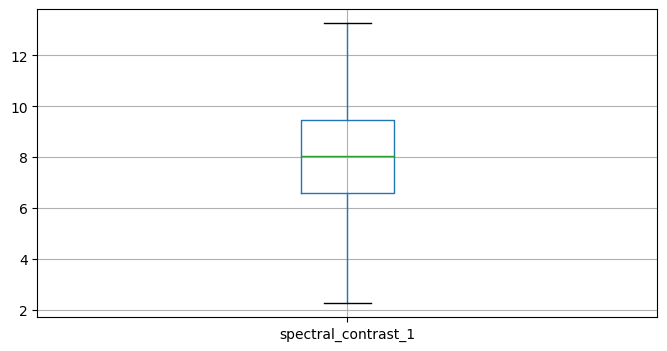

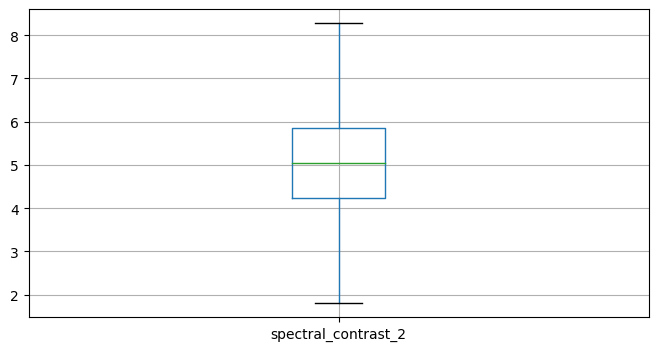

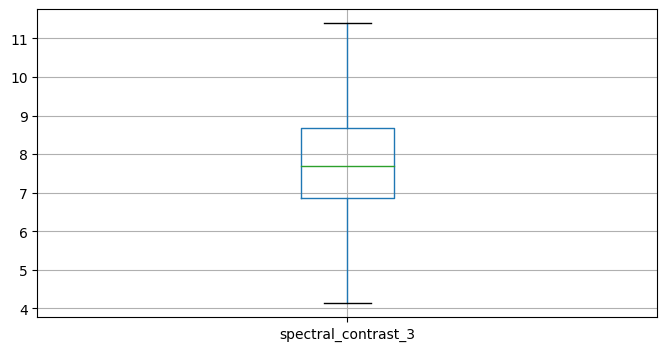

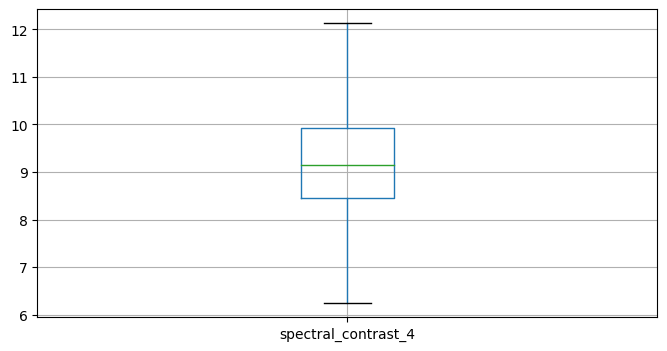

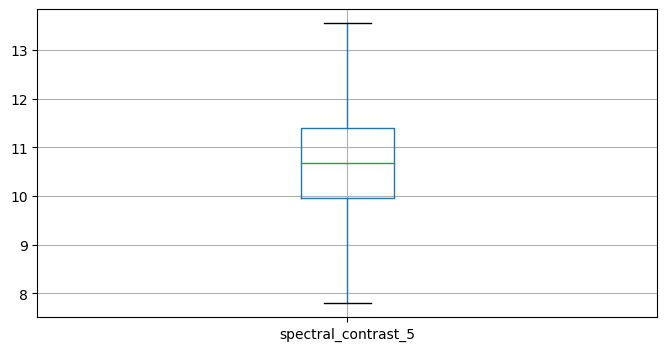

...

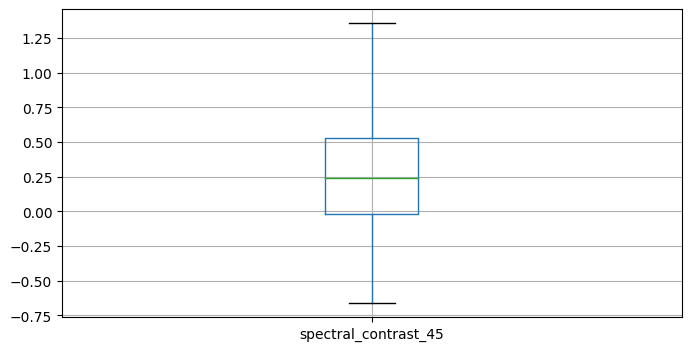

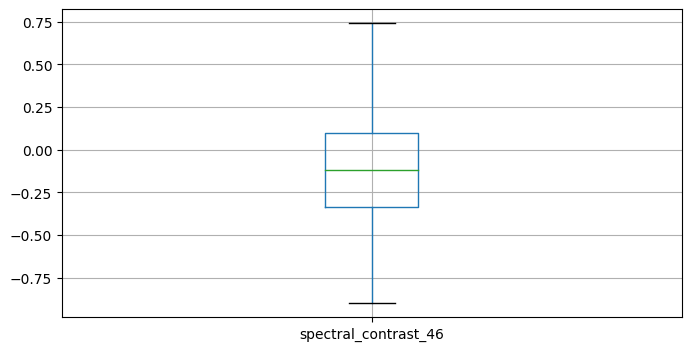

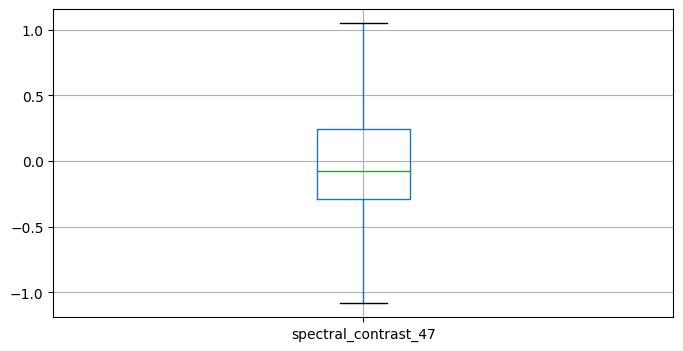

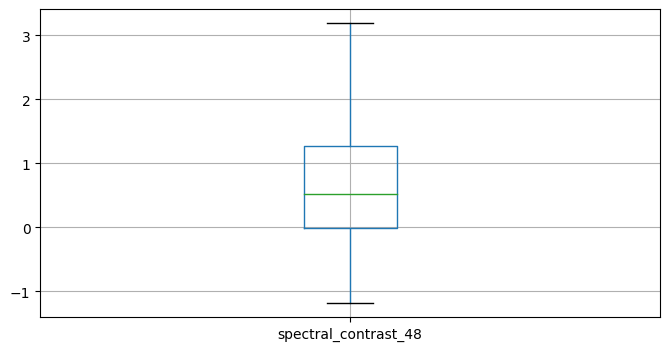

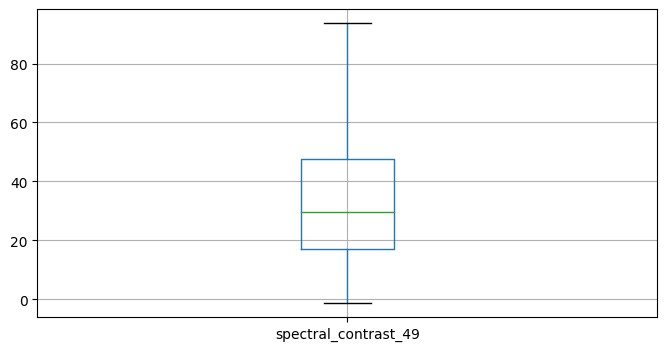

In [452]:
ranged_boxplot(data,'spectral_contrast_',49)

<ipython-input-417-274888e3d436>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


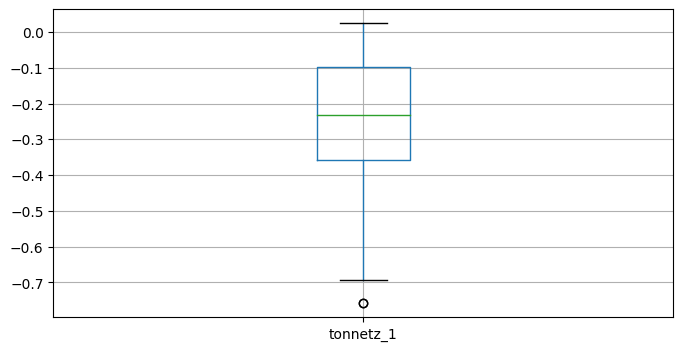

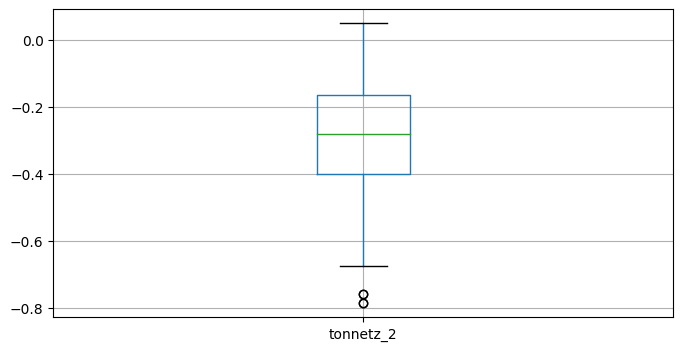

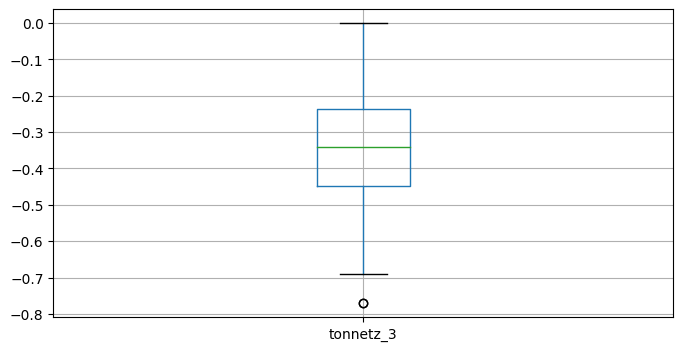

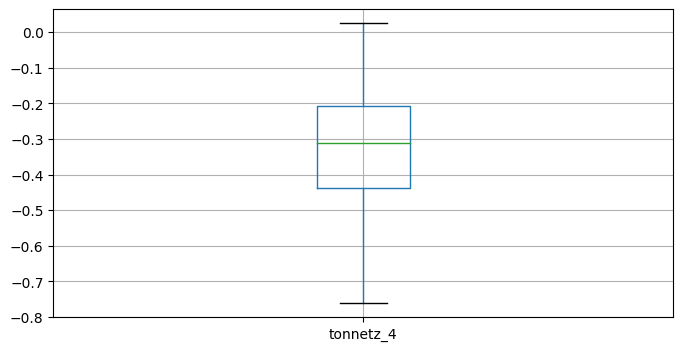

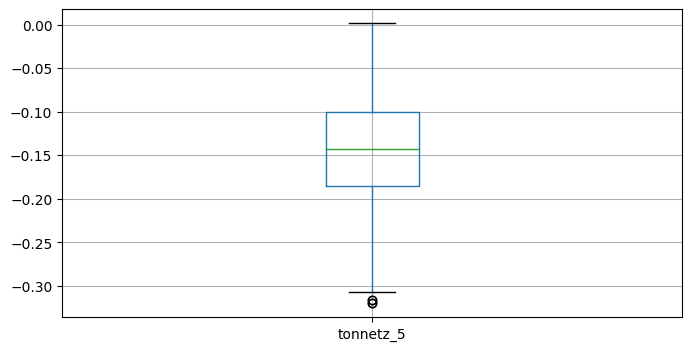

...

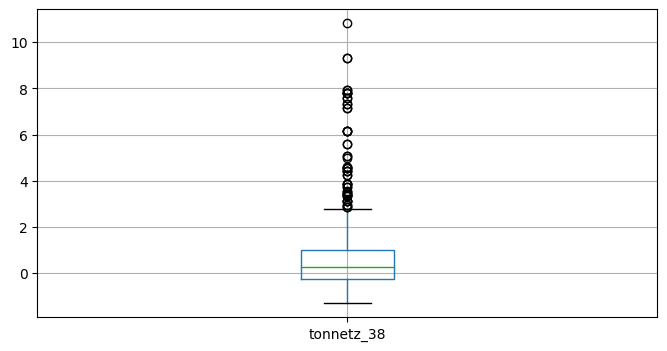

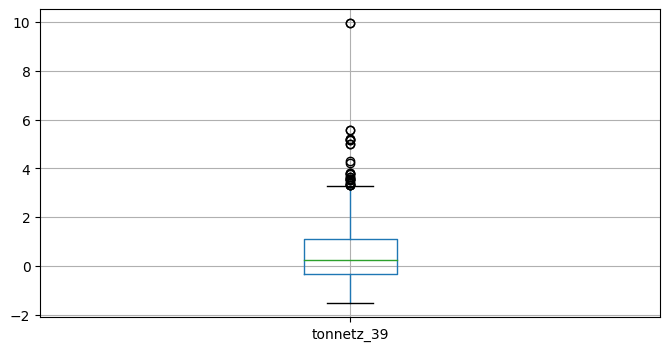

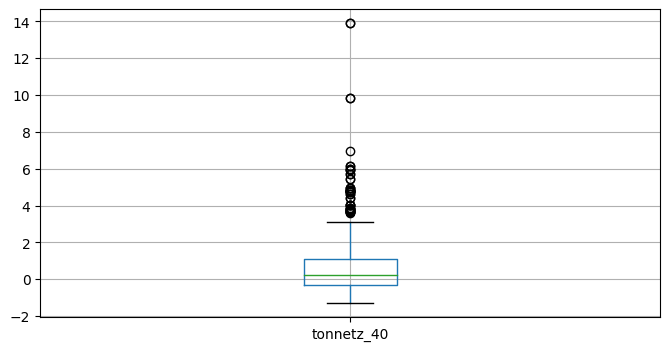

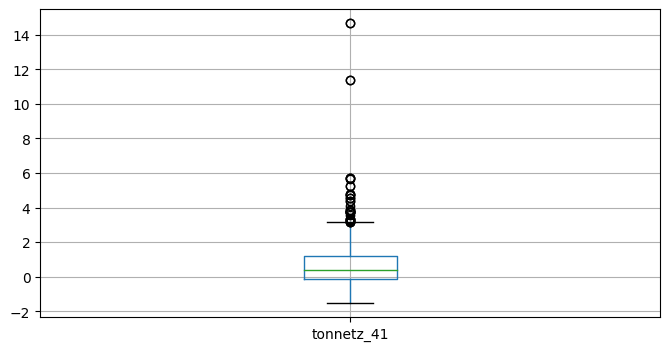

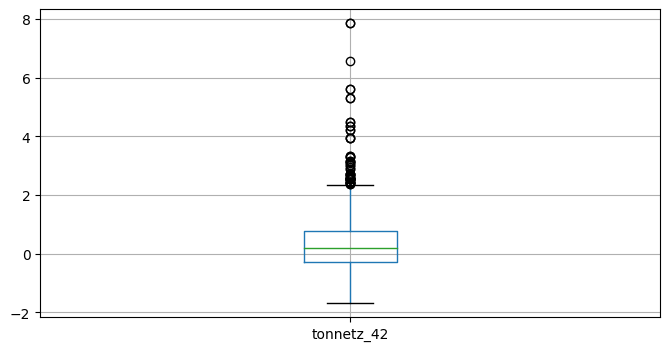

In [453]:
ranged_boxplot(data,'tonnetz_',42)

In [454]:
data = ranged_change_outlier(data,'tonnetz_',42)

<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the column with the column with removed outliers
<ipython-input-421-12aabeda5223>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[str(feture_name)+str(int(i+1))] = outlier_change(data[str(feture_name)+str(int(i+1))]) #exchanging the column in the copied dataframe for the the c

In [ ]:
ranged_boxplot(data,'tonnetz_',42)

so now that we tuned all of our outliers it's time to start working on represting the data

#visualization

starting with histograms for MFCC and Chroma features.

In [456]:
def ranged_histplot(data,feture_name,rangex):
 for i in range(rangex): #a ranged for loop to loop over the columns of a certain feature
  plt.figure(figsize=(8,4))
  sns.histplot(data,x=str(feture_name)+str(int(i+1)),kde=True) #the lopp expression

<ipython-input-456-ab9dce143b8f>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


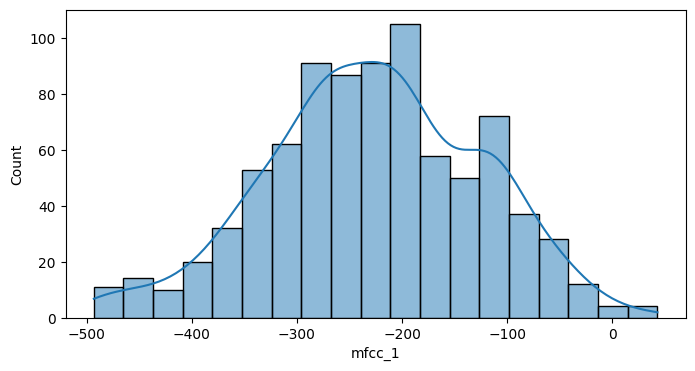

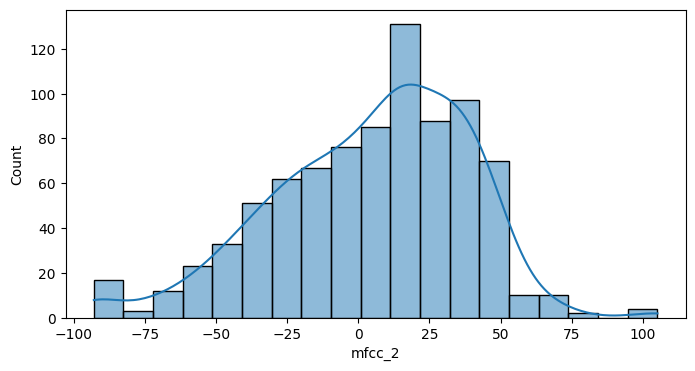

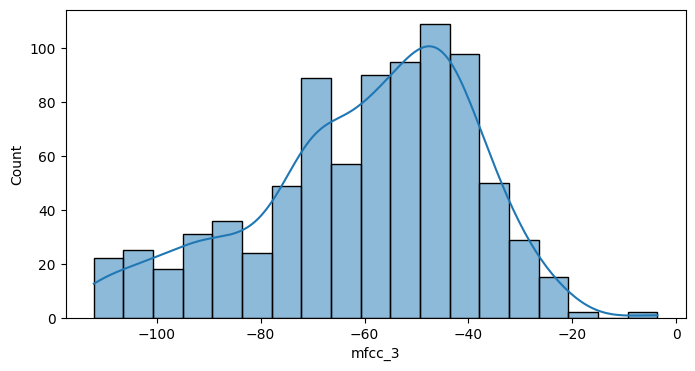

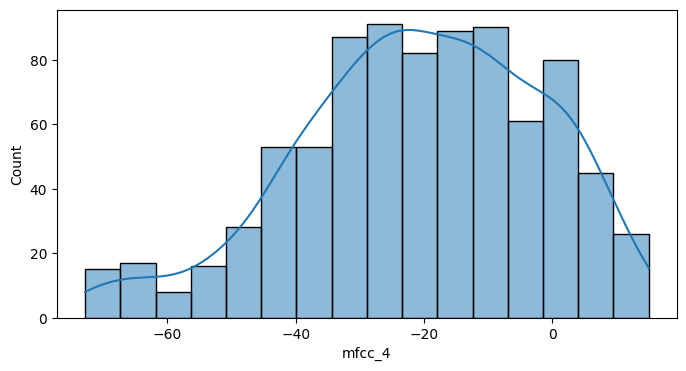

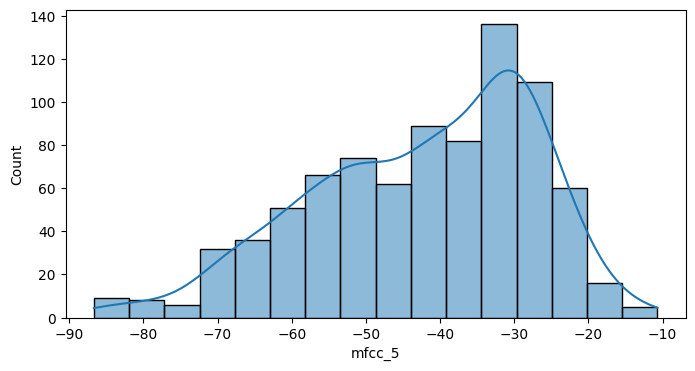

...

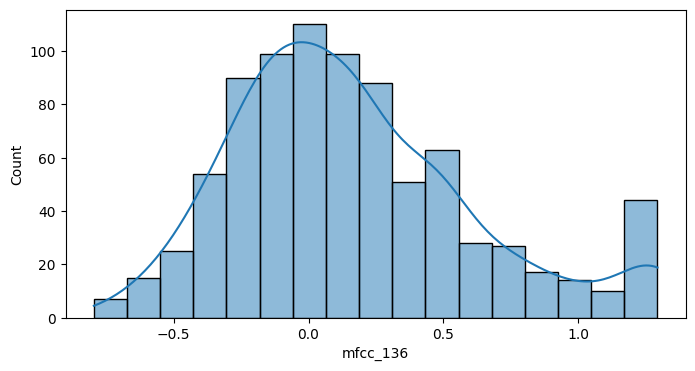

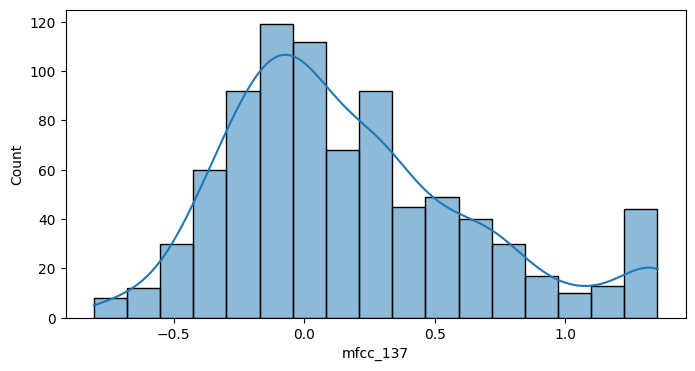

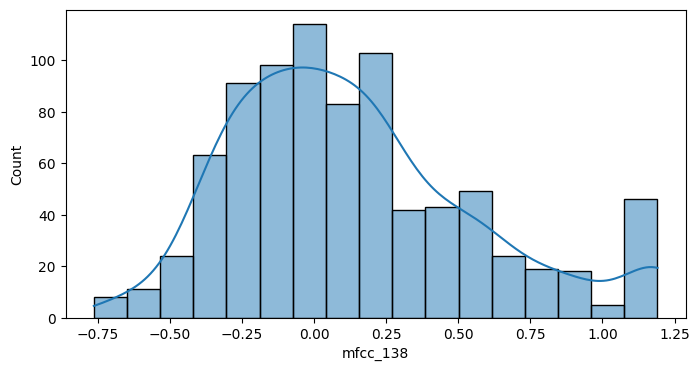

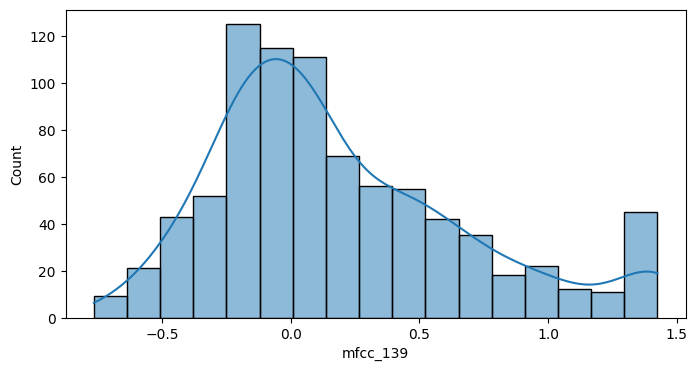

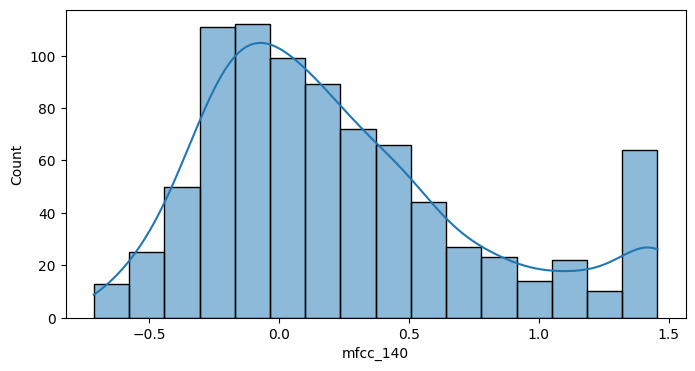

In [457]:
ranged_histplot(data,'mfcc_',140)

the data for mfcc is moslty normally distributed but tends to be shifted slightly towards the left which essentially means that songs tend to generally have higher mfccs

In [458]:
grouped = data.groupby(data.Label)
data_pop = grouped.get_group(1)
data_unpop=grouped.get_group(0)

analysing only pop data and non pop data to check for differences

<ipython-input-456-ab9dce143b8f>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


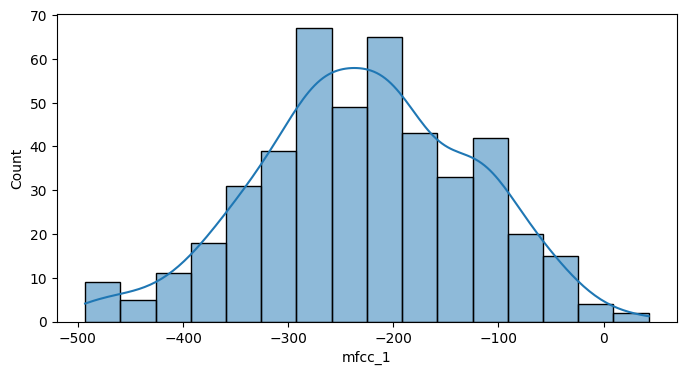

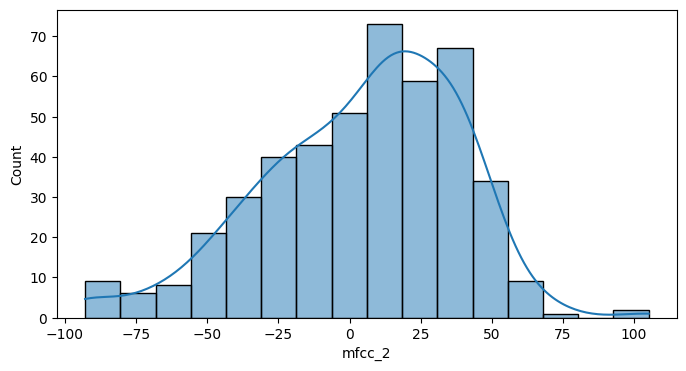

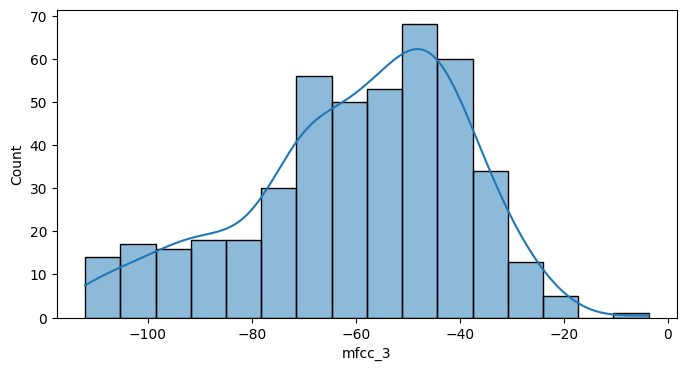

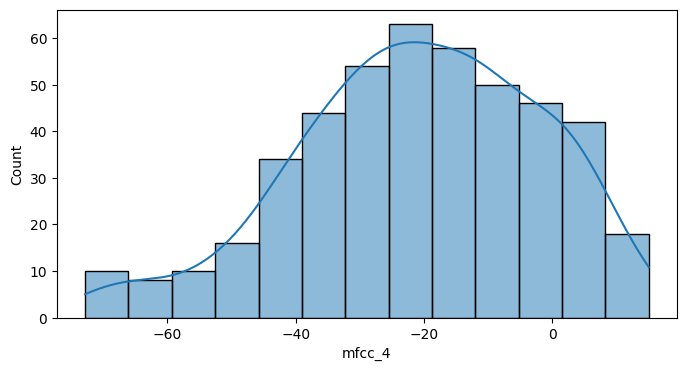

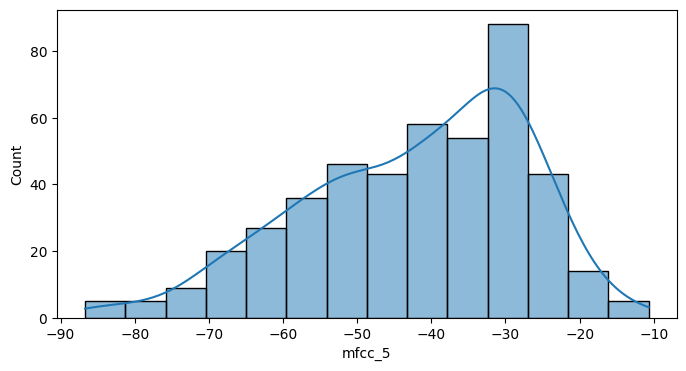

...

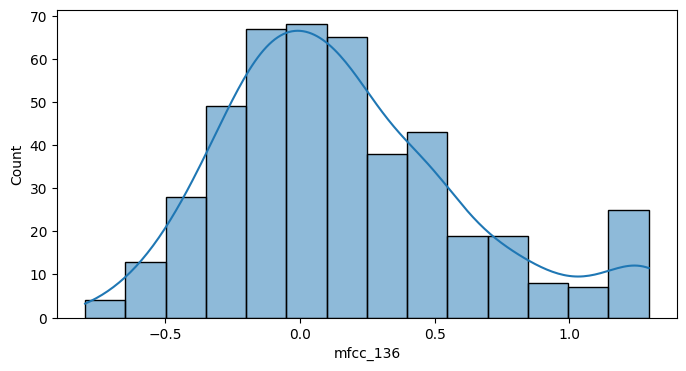

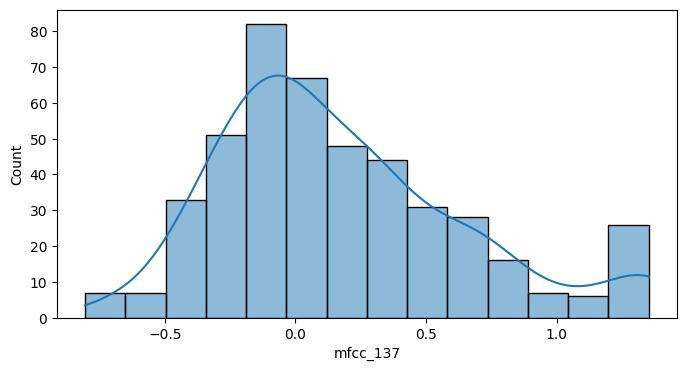

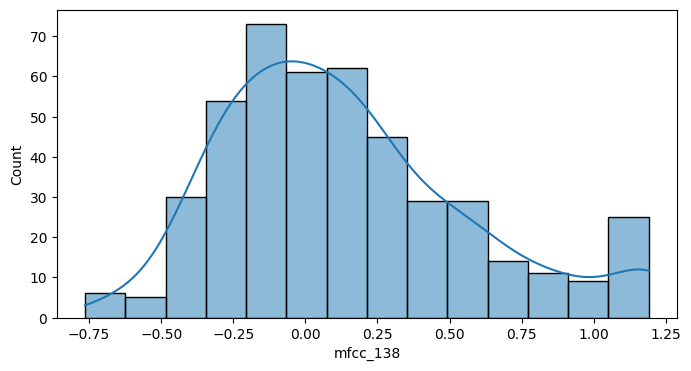

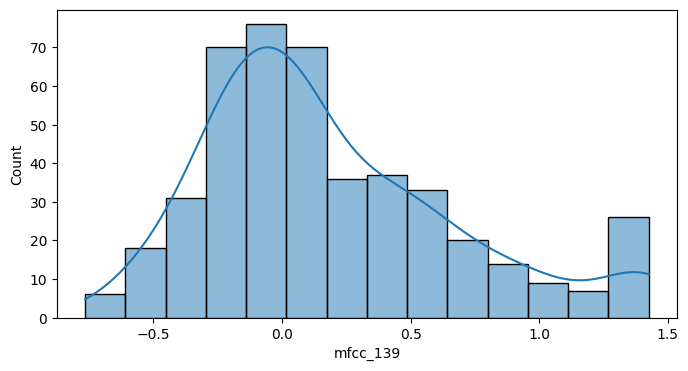

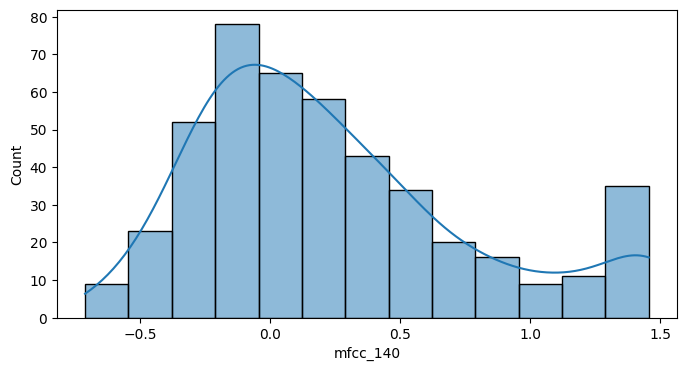

In [459]:
ranged_histplot(data_pop,'mfcc_',140)

<ipython-input-456-ab9dce143b8f>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


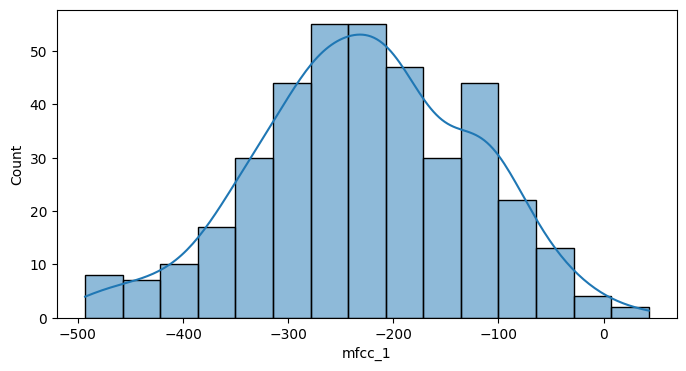

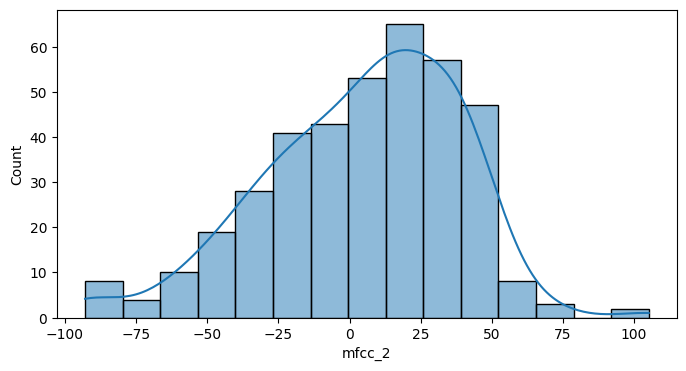

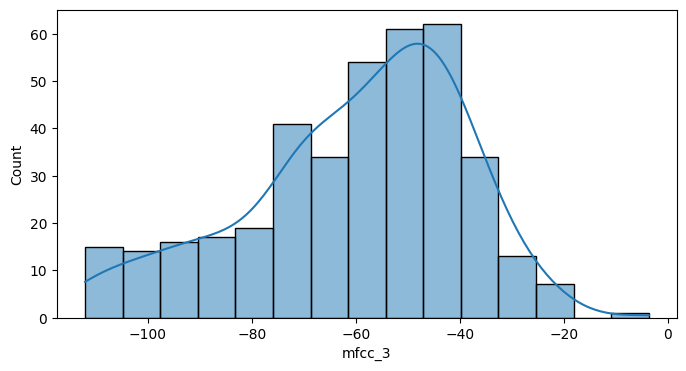

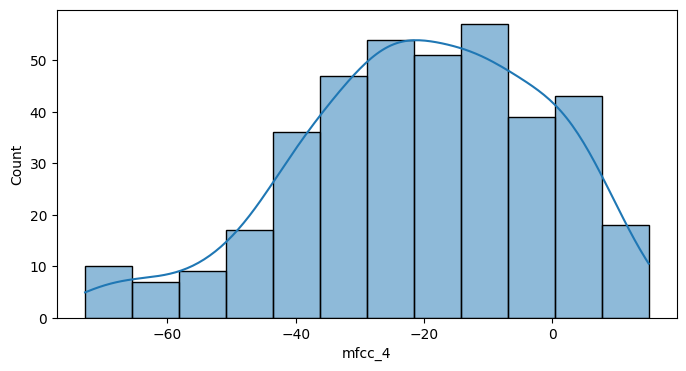

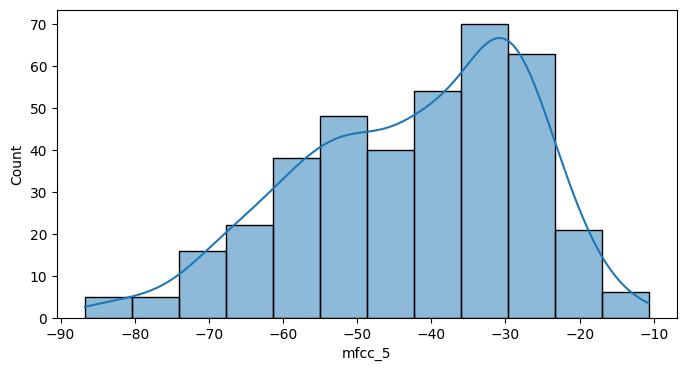

...

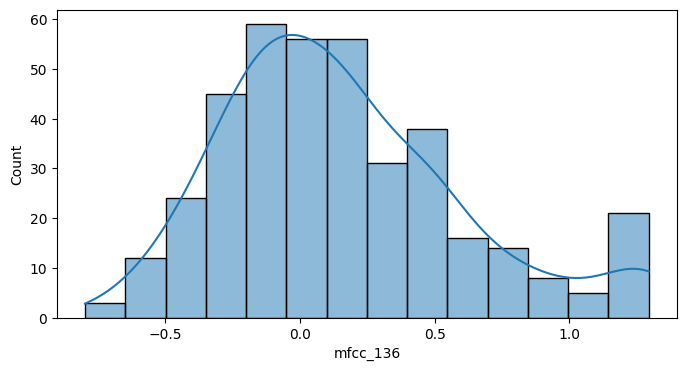

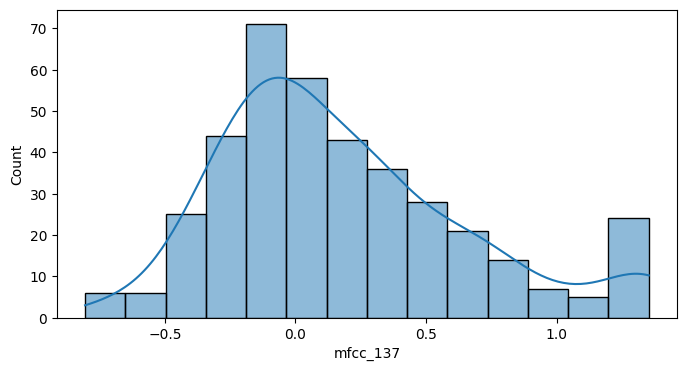

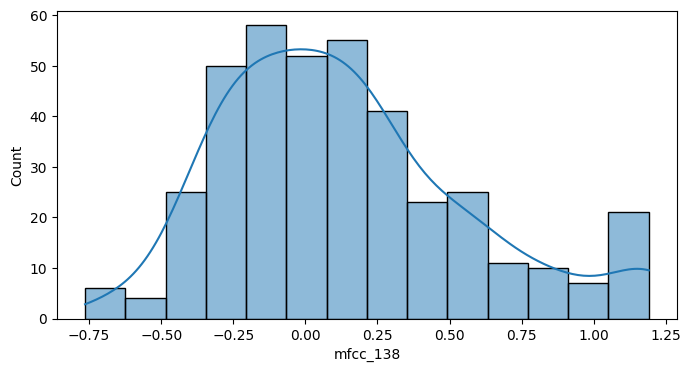

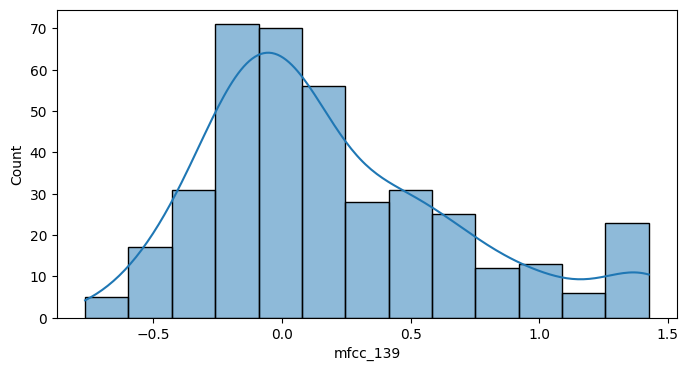

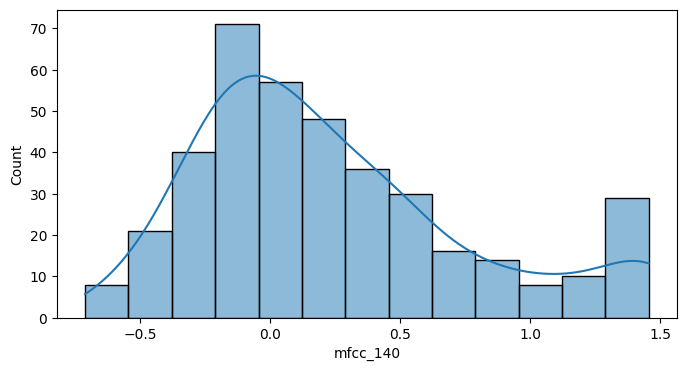

In [460]:
ranged_histplot(data_unpop,'mfcc_',140)

there seems to be slight differences in the mfcc curves between popular and unpopular data which means that it will affect our model accuarcy by a slight bit

<ipython-input-456-ab9dce143b8f>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


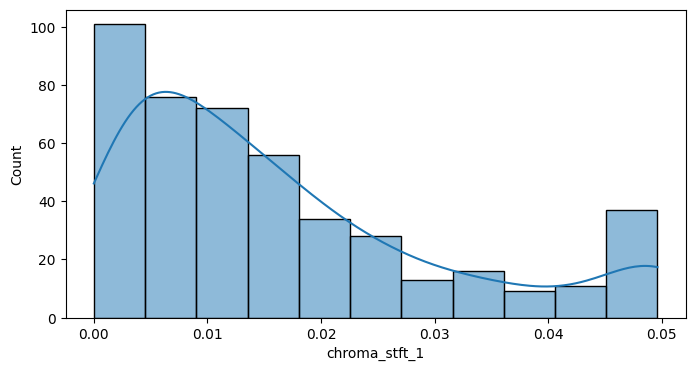

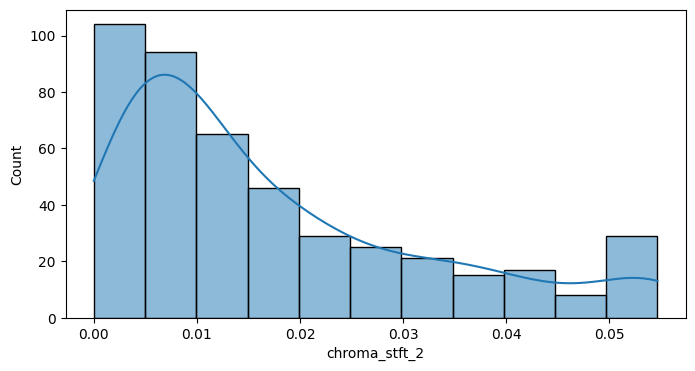

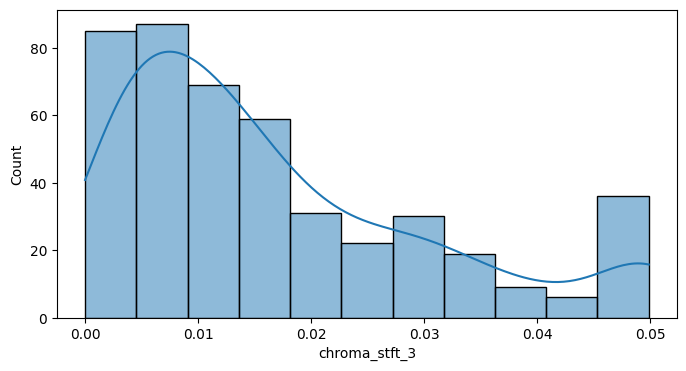

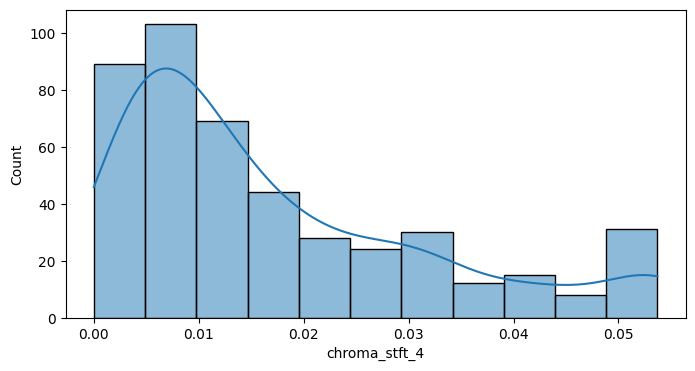

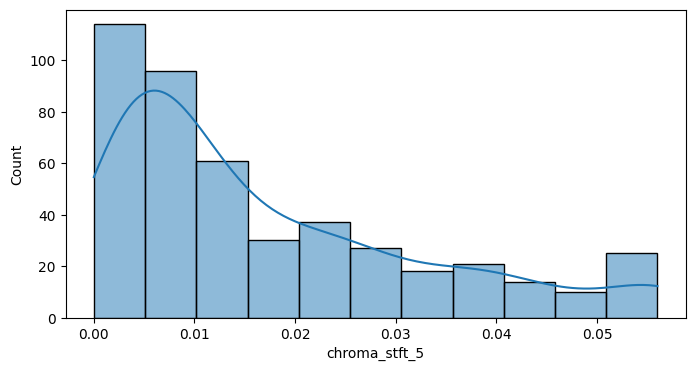

...

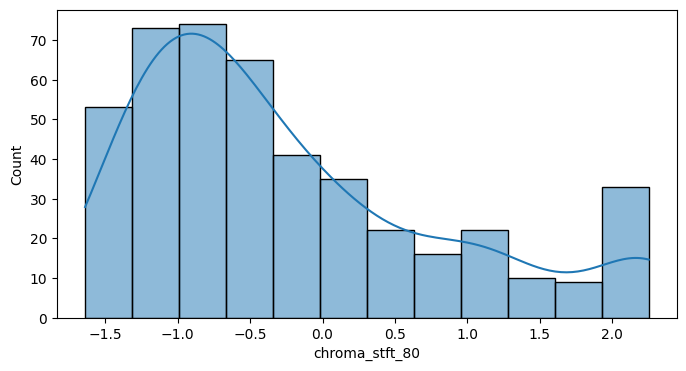

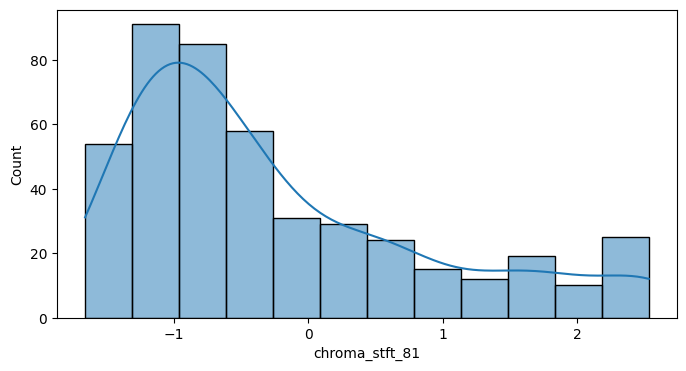

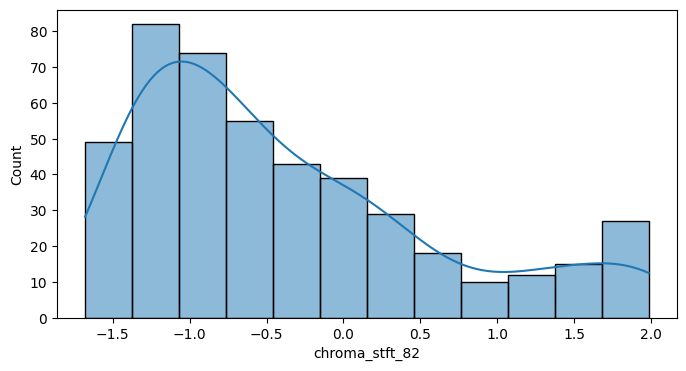

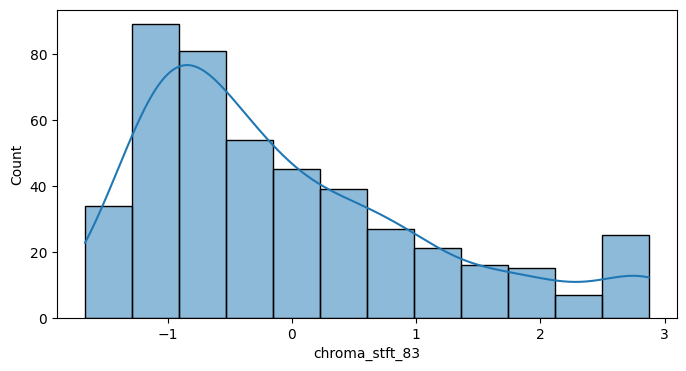

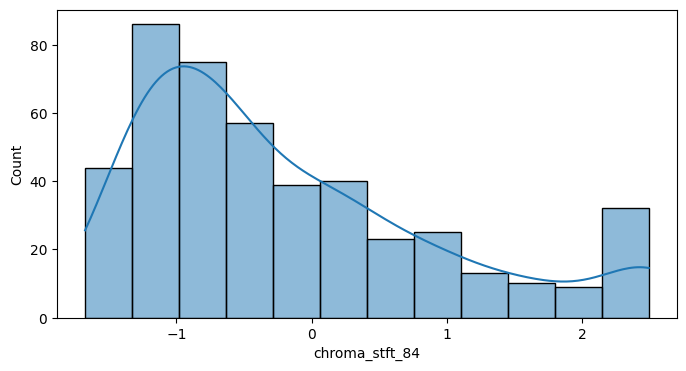

In [461]:
ranged_histplot(data_pop,'chroma_stft_',84)

<ipython-input-456-ab9dce143b8f>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,4))


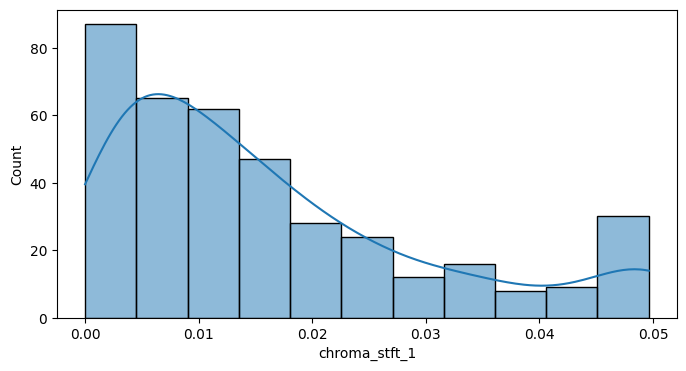

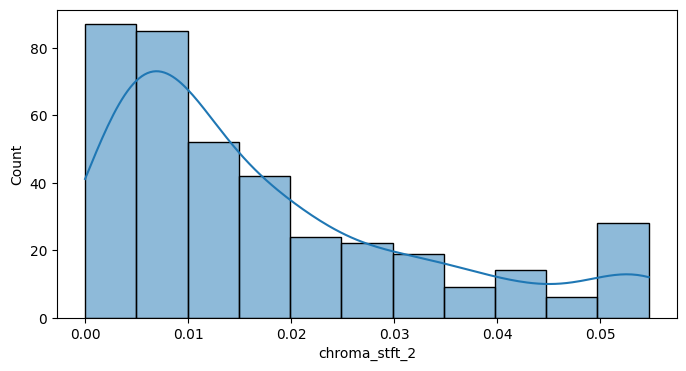

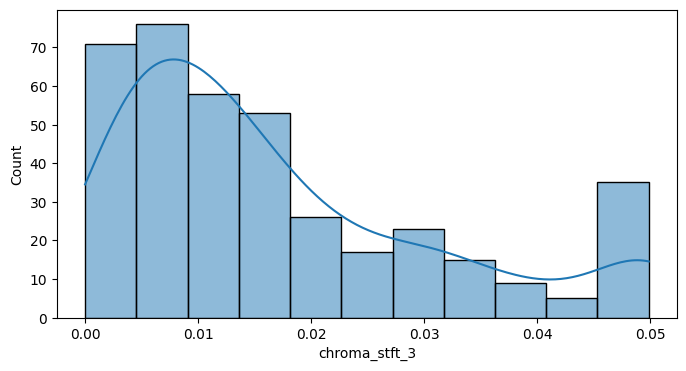

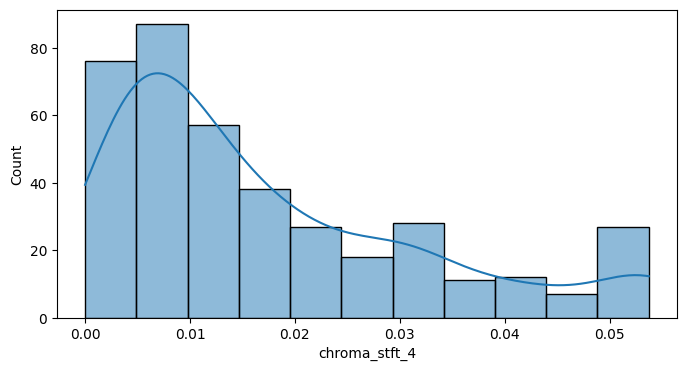

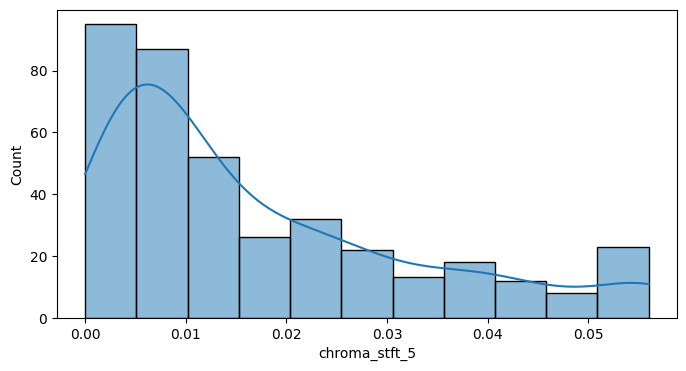

...

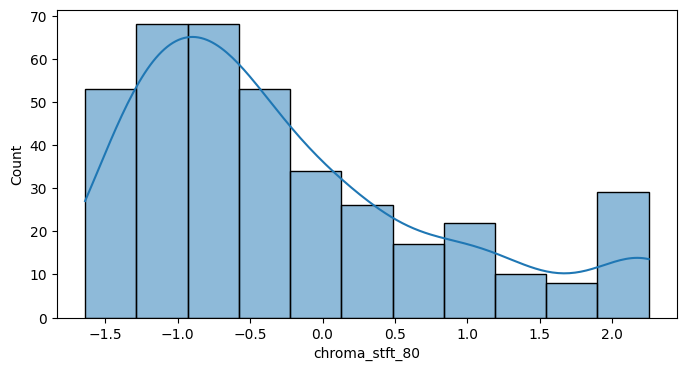

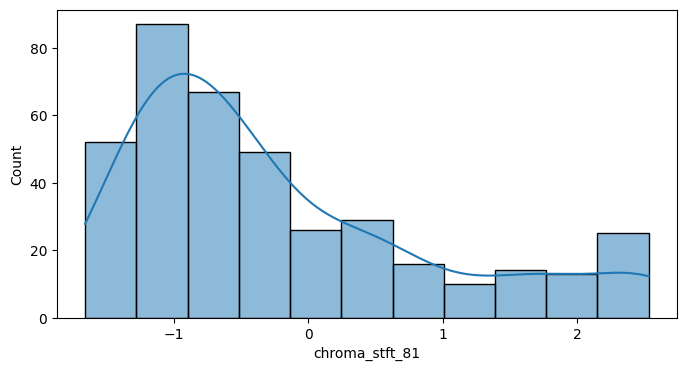

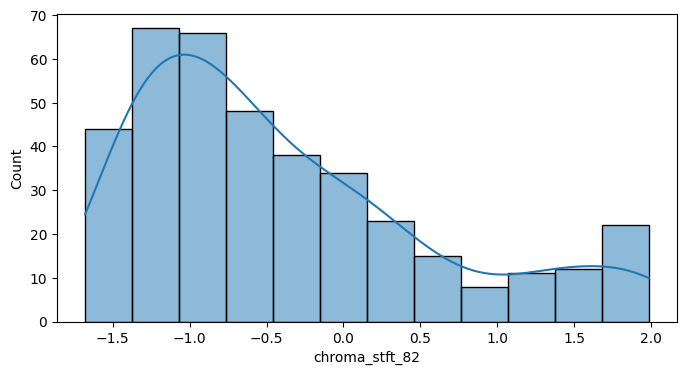

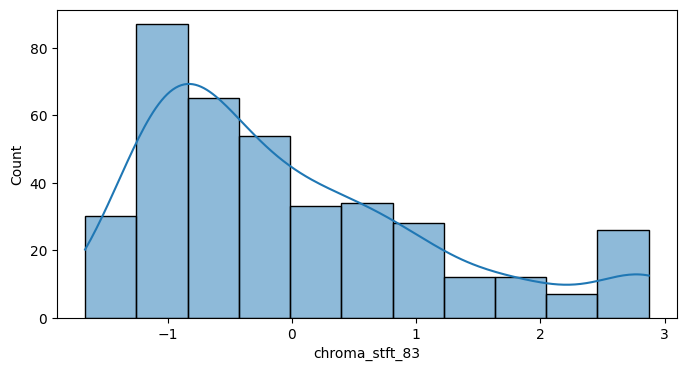

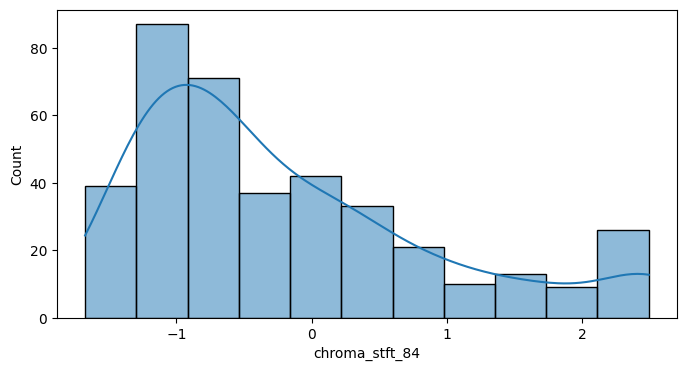

In [462]:
ranged_histplot(data_unpop,'chroma_stft_',84)

there are slight differences between the tendacies of the chroma stft features and after removing the outliers features from 37 to 48 seem to just have 1 as a value so they don't seem to be important at all

In [ ]:
ranged_histplot(data_pop,'chroma_cqt_',84)

In [ ]:
ranged_histplot(data_unpop,'chroma_cqt_',84)

the cqt seems to be normally distributed with features from 37 to 46 to be one value and 47 being weirdly distributed across 0 and minor values

In [ ]:
ranged_histplot(data_pop,'chroma_cens_',84)

In [ ]:
ranged_histplot(data_unpop,'chroma_cens_',84)

the chroma cens features don't have much differences but some of the graphs seem to be normally distributed while other graphs are very shifted towards the right

In [467]:
data_mfcc = data.iloc[:,3:143]
data_mfcc1 = data.iloc[:,3+10:33+10]
data_mfcc2 = data.iloc[:,3+40:33+40]
data_mfcc3 = data.iloc[:,3+70:33+70]
data_mfcc4 = data.iloc[:,3+100:33+100]
data_mfcc5 = data.iloc[:,3+130:23+130]

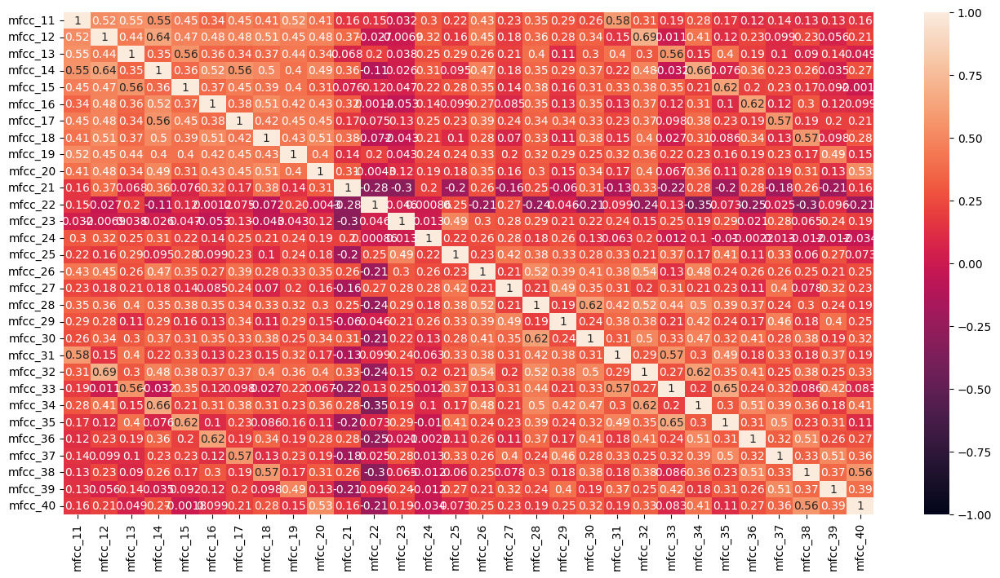

In [468]:
plt.figure(figsize=(16,8))
sns.heatmap(data_mfcc1.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

In [ ]:
plt.figure(figsize=(16,8))
sns.heatmap(data_mfcc2.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

In [ ]:
plt.figure(figsize=(16,8))
sns.heatmap(data_mfcc3.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

In [ ]:
plt.figure(figsize=(16,8))
sns.heatmap(data_mfcc4.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

In [ ]:
plt.figure(figsize=(16,8))
sns.heatmap(data_mfcc5.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

there is some heavy correlation between between some mfcc features and some features have very little correlation but still alot of them are heavily correlation so merging them in some form or another would do us good

In [ ]:
# calculate correlation matrix

corr_matrix = data_mfcc.corr().abs()

# print correlation matrix

print(corr_matrix)

In [474]:
# get upper triangle of correlation matrix
datad=data.iloc[:,0:521]
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)

<ipython-input-474-55ccf9cc436b>:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


In [ ]:
datad

In [476]:
data_chroma_stft1 = data.iloc[:,143:180]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_chroma_stft1.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

for the chroma stft it's very noticable that every number of features are correlated features from 1 to 12 have a very good correlation and features from 13 to 36 have a repeating correlation pattern it's very noticible from features 13 to 24 and from 26 to 37

In [478]:
data_chroma_stft2 = data.iloc[:,143+12:180+12]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_chroma_stft2.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

since features from 37 to 48 just have the value 1 in all rows they can't show any correlation which makes sense and we will probably have to drop those features

In [480]:
data_chroma_stft3 = data.iloc[:,143+12+36:180+12+35]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_chroma_stft3.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

features from 49 to 60 have a very high negative correlation between them and features from 73 to 84 and features from 61 to 72 have a good correlation between them and themselves which is invertly repeated from the start of the chroma stft in the first graph

In [482]:
data_chroma_stft = data.iloc[:,143:227]
# calculate correlation matrix

corr_matrix = data_chroma_stft.corr().abs()

# print correlation matrix

print(corr_matrix)

                chroma_stft_1  chroma_stft_2  chroma_stft_3  chroma_stft_4  \
chroma_stft_1        1.000000       0.777091       0.624118       0.628369   
chroma_stft_2        0.777091       1.000000       0.765424       0.632832   
chroma_stft_3        0.624118       0.765424       1.000000       0.752728   
chroma_stft_4        0.628369       0.632832       0.752728       1.000000   
chroma_stft_5        0.635091       0.621654       0.619628       0.772774   
...                       ...            ...            ...            ...   
chroma_stft_80       0.008146       0.116557       0.155654       0.110357   
chroma_stft_81       0.056990       0.022840       0.015211       0.082014   
chroma_stft_82       0.020188       0.007037       0.022993       0.091491   
chroma_stft_83       0.020755       0.000886       0.015578       0.034693   
chroma_stft_84       0.094842       0.021582       0.100572       0.142168   

                chroma_stft_5  chroma_stft_6  chroma_stft_7  ch

In [483]:
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)

<ipython-input-483-1a4fdff36b85>:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


In [ ]:
datad

In [485]:
data_chroma_cqt1=data.iloc[:,255:255+37]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_chroma_cqt1.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

for the chroma cqt we can see that we have exactly the same correlation pattern as the chroma stft with perctiles of differences between them

In [487]:
data_chroma_cqt=data.iloc[:,255:255+84]
# calculate correlation matrix

corr_matrix = data_chroma_cqt.corr().abs()

# print correlation matrix

print(corr_matrix)

               chroma_cqt_1  chroma_cqt_2  chroma_cqt_3  chroma_cqt_4  \
chroma_cqt_1       1.000000      0.768775      0.666828      0.717965   
chroma_cqt_2       0.768775      1.000000      0.708758      0.705614   
chroma_cqt_3       0.666828      0.708758      1.000000      0.711831   
chroma_cqt_4       0.717965      0.705614      0.711831      1.000000   
chroma_cqt_5       0.702698      0.672919      0.625529      0.759448   
...                     ...           ...           ...           ...   
chroma_cqt_80      0.004266      0.022987      0.022731      0.094878   
chroma_cqt_81      0.151629      0.191981      0.041488      0.108161   
chroma_cqt_82      0.190342      0.153421      0.169089      0.287043   
chroma_cqt_83      0.298510      0.307574      0.241558      0.235911   
chroma_cqt_84      0.359294      0.278251      0.232292      0.284623   

               chroma_cqt_5  chroma_cqt_6  chroma_cqt_7  chroma_cqt_8  \
chroma_cqt_1       0.702698      0.756756      0.6

In [488]:
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)
datad

<ipython-input-488-519594ce2e0b>:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_9,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-19.957939,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-40.412464,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-53.533844,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-51.192085,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-31.860609,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-34.696373,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-37.037346,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.365357
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-27.439772,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-34.501373,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


In [489]:
data_chroma_cens1=data.iloc[:,339:339+37]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_chroma_cens1.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

for the chroma cens we see the same pattern like the other chromas just a bit lower correlation in the first 12 lines with some negative correaltions because we log transformed it to normalize the data more but in actuality it's exactly the same pattern

In [491]:
data_chroma_cens=data.iloc[:,339:339+84]
# calculate correlation matrix

corr_matrix = data_chroma_cens.corr().abs()

# print correlation matrix

print(corr_matrix)

                chroma_cens_1  chroma_cens_2  chroma_cens_3  chroma_cens_4  \
chroma_cens_1        1.000000       0.467392       0.250774       0.326575   
chroma_cens_2        0.467392       1.000000       0.407246       0.424344   
chroma_cens_3        0.250774       0.407246       1.000000       0.410869   
chroma_cens_4        0.326575       0.424344       0.410869       1.000000   
chroma_cens_5        0.306797       0.259746       0.265481       0.457869   
...                       ...            ...            ...            ...   
chroma_cens_80       0.208638       0.154059       0.001594       0.137800   
chroma_cens_81       0.045768       0.104364       0.067712       0.045723   
chroma_cens_82       0.127828       0.160335       0.024295       0.195732   
chroma_cens_83       0.056395       0.034873       0.019773       0.096938   
chroma_cens_84       0.119627       0.130440       0.028581       0.077294   

                chroma_cens_5  chroma_cens_6  chroma_cens_7  ch

In [492]:
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)
datad

<ipython-input-492-519594ce2e0b>:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_9,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-19.957939,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-40.412464,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-53.533844,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-51.192085,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-31.860609,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-34.696373,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-37.037346,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.365357
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-27.439772,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-34.501373,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


In [493]:
data_contrast1 = data.iloc[:,430:430+36]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_contrast1.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

for spectral contrast we can see that the data is clustered in its correlation into 7 groups

In [495]:
data_contrast = data.iloc[:,430:430+49]
# calculate correlation matrix

corr_matrix = data_contrast.corr().abs()

# print correlation matrix

print(corr_matrix)

                      spectral_contrast_1  spectral_contrast_2  \
spectral_contrast_1              1.000000             0.179146   
spectral_contrast_2              0.179146             1.000000   
spectral_contrast_3              0.027146             0.452057   
spectral_contrast_4              0.103433             0.423927   
spectral_contrast_5              0.052790             0.369500   
spectral_contrast_6              0.024150             0.182179   
spectral_contrast_7              0.082202             0.096703   
spectral_contrast_8              0.303273             0.097021   
spectral_contrast_9              0.126183             0.343671   
spectral_contrast_10             0.096542             0.362913   
spectral_contrast_11             0.082336             0.314824   
spectral_contrast_12             0.135728             0.313605   
spectral_contrast_13             0.146253             0.289655   
spectral_contrast_14             0.169220             0.238019   
spectral_c

In [496]:
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)
datad

<ipython-input-496-519594ce2e0b>:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_9,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-19.957939,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-40.412464,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-53.533844,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-51.192085,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-31.860609,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-34.696373,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-37.037346,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.365357
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-27.439772,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-34.501373,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


In [497]:
data_toonetz=data.iloc[:,479:479+42]

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(data_toonetz.corr(),vmin=-1,vmax=1,annot=True)
plt.show()

for toontez we can see that the data is clustred into with the first 6 features relating to each other and the features from 19 through 30 having a negative relation with the first 6 and having a high correlation with each other also the last 6 show a slight correlation with each otherwise also features from 7 to 22 have a cascading correlation with features from 1 to 16

In [499]:
# calculate correlation matrix

corr_matrix = data_toonetz.corr().abs()

# print correlation matrix

print(corr_matrix)

            tonnetz_1  tonnetz_2  tonnetz_3  tonnetz_4  tonnetz_5  tonnetz_6  \
tonnetz_1    1.000000   0.127662   0.279837   0.168274   0.323687   0.279105   
tonnetz_2    0.127662   1.000000   0.302939   0.399917   0.302491   0.351769   
tonnetz_3    0.279837   0.302939   1.000000   0.302394   0.515512   0.480907   
tonnetz_4    0.168274   0.399917   0.302394   1.000000   0.446932   0.441511   
tonnetz_5    0.323687   0.302491   0.515512   0.446932   1.000000   0.478208   
tonnetz_6    0.279105   0.351769   0.480907   0.441511   0.478208   1.000000   
tonnetz_7    0.793225   0.027271   0.038159   0.113667   0.015858   0.079724   
tonnetz_8    0.031149   0.724049   0.037657   0.112135   0.012446   0.054885   
tonnetz_9    0.009400   0.057278   0.511359   0.038009   0.083902   0.004400   
tonnetz_10   0.052122   0.112527   0.036388   0.629543   0.088577   0.012707   
tonnetz_11   0.037417   0.005007   0.081640   0.109683   0.494827   0.133049   
tonnetz_12   0.072634   0.110238   0.029

In [ ]:
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# find features with correlation greater than 0.95

to_drop = [column for column in upper.columns if any(upper[column] > 0.60)]

# drop highly correlated features

datad.drop(to_drop, axis=1, inplace=True)
datad

#statistical analysis

In [ ]:
for i in range(0,520,20):
 display(data.iloc[:,i:i+20].describe())

for the mfcc there's a clear distinction between the groups of feautres as it has a cascading decrease in the mean magnitude in value mfcc_1 has the heighst mean and standard deviation while the mfcc_130 has the lowest mean and standard deviation so it isn't a decreasing constant pattern but it follows a trend where lower features tend to be more voltile with higher means and std's and higher features tend to have a more constraint value with lower values and std's

for chroma stft for the first 12 features having a very similar medians and std's that's not surprising as we noticed that they a very correlated through the heat map and features from 13 to 36 have a very similar means and std's again not that surprising because they were very correlated from the heat map features 37 to 48 have a single value which is 1 and for the rest we have some more relation between feature 49 to 60 and 61 to 70 they are all very similar and can be merged into 10 features since they follow a cascading correlation between the first 10 and last 10 and from 61 to 72 have a very postive ralation to features from 73 to 84 so the whole of chroma can be really combined into 10 features as the same goes for the rest of the chroma features so we can depend on one of the three chroma features and have them combined into 10 features

for spectral centroid and bandwidth it's noticible that all the 7 features have no relation to each other as each one represents a different thing entirely same goes for the rms,zero crossing rate and rolloff

for spectral contrast we see that every 7 features are close to each other and they are split into 7 different groups which essentially tells us that we may combine every 7 features into one feature and reduce spectral contrast to 7 features

now we have to drop all of the identical feature aka 37 to 48 in chroma features

In [502]:
for i in range (37,49):
 datad=datad.drop(['chroma_stft_'+str(i)], axis=1)

In [503]:
datad

,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_9,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-19.957939,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-40.412464,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-53.533844,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-51.192085,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-31.860609,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-34.696373,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-37.037346,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.365357
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-27.439772,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-34.501373,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


In [504]:
for i in range (37,49):
 datad=datad.drop(['chroma_cqt_'+str(i)], axis=1)

In [505]:
datad

,Artist,Title,Label,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_9,...,tonnetz_33,tonnetz_34,tonnetz_35,tonnetz_36,tonnetz_37,tonnetz_38,tonnetz_39,tonnetz_40,tonnetz_41,tonnetz_42
0,Drake,God's Plan,1,-52.681419,18.093800,-43.018349,11.148930,-20.784912,-1.820989,-19.957939,...,-0.237513,0.680783,-1.003095,-0.617152,0.247133,-1.042533,-1.213663,-0.493831,0.035904,-0.609936
1,Ed Sheeran,Perfect,1,-151.794296,23.712065,-20.703772,-13.300804,-25.163881,-14.943703,-40.412464,...,0.612480,-0.259771,-0.242060,0.145908,-0.489129,0.380625,-0.419461,0.494993,0.904241,-0.804120
2,Bebe Rexha & Florida Georgia Line,Meant To Be,1,-291.197357,3.196505,-61.178947,-30.973726,-40.361481,-43.557144,-53.533844,...,0.282735,0.297781,-0.063134,0.814340,-0.194138,0.028803,-0.691077,-0.323472,0.299612,0.223415
3,Camila Cabello Featuring Young Thug,Havana,1,-206.627151,-1.952857,-69.880974,-33.325855,-53.520065,-31.170767,-51.192085,...,0.053657,-0.445166,-0.771630,0.104478,1.041904,-0.838797,-0.453482,-0.078820,0.832103,0.101768
4,Post Malone Featuring 21 Savage,Rockstar,1,-267.380310,-32.153942,-87.945473,-4.127285,-59.690155,-69.393654,-31.860609,...,-0.476972,-0.557637,-0.432738,-0.818221,0.612012,1.869386,0.205767,2.573488,0.231287,1.604251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,Jon Pardi,Head Over Boots,0,-226.302399,43.759911,-33.674225,-7.168710,-40.210239,-11.743730,-34.696373,...,0.461042,-0.048893,-0.191312,0.662371,-0.359235,0.793127,0.156289,0.141184,0.145683,0.387550
839,Jon Pardi,Heartache Medication,0,-192.165161,23.868328,-53.809113,1.935415,-40.695660,-11.667664,-37.037346,...,0.122867,-0.493610,-0.672806,1.181026,1.464300,0.376734,1.258131,0.319688,0.307817,2.365357
840,Jon Pardi,Heartache On The Dance Floor,0,-286.026184,52.642498,-58.924629,-9.045342,-40.608467,-9.778732,-27.439772,...,0.118677,-0.604628,-0.946643,0.896816,0.640279,-0.274241,0.066778,1.492133,2.332573,1.423217
841,JNR CHOI & Sam Tompkins,"TO THE MOON (feat. Fivio Foreign, Russ Million...",0,-299.131409,-59.380386,-93.518967,-17.524561,-41.644901,-30.729004,-34.501373,...,1.116017,0.394860,1.116914,-0.161392,-0.069028,1.501868,0.701756,-0.268198,0.710003,1.106647


#conclusion

features are split into 7 corelations and mostly all features can be reduced by splitting them based on sevens segments (combining every 7 features into 1)

#PCA

In [545]:
from sklearn.decomposition import PCA
pca = PCA(n_components=171)
datax=datad.drop(['Artist','Title','Label'],axis=1)
datax=StandardScaler().fit_transform(datax)
principlecomps=pca.fit_transform(datax)

In [546]:
sum(pca.explained_variance_ratio_)*100

95.3781485469186

In [547]:
columns= list (range(171))
for i in range (171) :
  columns[i] = 'priciple_component_'+ str(i+1)
print(columns)

['priciple_component_1', 'priciple_component_2', 'priciple_component_3', 'priciple_component_4', 'priciple_component_5', 'priciple_component_6', 'priciple_component_7', 'priciple_component_8', 'priciple_component_9', 'priciple_component_10', 'priciple_component_11', 'priciple_component_12', 'priciple_component_13', 'priciple_component_14', 'priciple_component_15', 'priciple_component_16', 'priciple_component_17', 'priciple_component_18', 'priciple_component_19', 'priciple_component_20', 'priciple_component_21', 'priciple_component_22', 'priciple_component_23', 'priciple_component_24', 'priciple_component_25', 'priciple_component_26', 'priciple_component_27', 'priciple_component_28', 'priciple_component_29', 'priciple_component_30', 'priciple_component_31', 'priciple_component_32', 'priciple_component_33', 'priciple_component_34', 'priciple_component_35', 'priciple_component_36', 'priciple_component_37', 'priciple_component_38', 'priciple_component_39', 'priciple_component_40', 'pricipl

In [548]:
principledf = pd.DataFrame(data=principlecomps,columns=columns)

In [553]:
fdf=pd.concat([datad.Artist,datad.Title,datad.Label,principledf],axis=1)

In [559]:
fdf=fdf.dropna()

In [560]:
fdf.to_csv('PCA_data.csv',index=False)
datad.to_csv('data_without_pca.csv',index=False)